Mounted at /content/drive

--- Binning Summary ---
Full y-range: min = 46.00, max = 817.10
Detected outliers: 0 (0.00%)
Filtered y-range (without outliers): min = 46.00, max = 817.10
Number of detected peaks = 7
Primary method: KDE peak detection
Number of bins = 7
Δy Variability: 0.04 (Max-Min)/Mean
Final Bin Edges: [ 64.83367367 154.447998   243.5991992  333.13633634 421.9016016
 510.66686687 597.11651652 686.73084084]
-----------------------



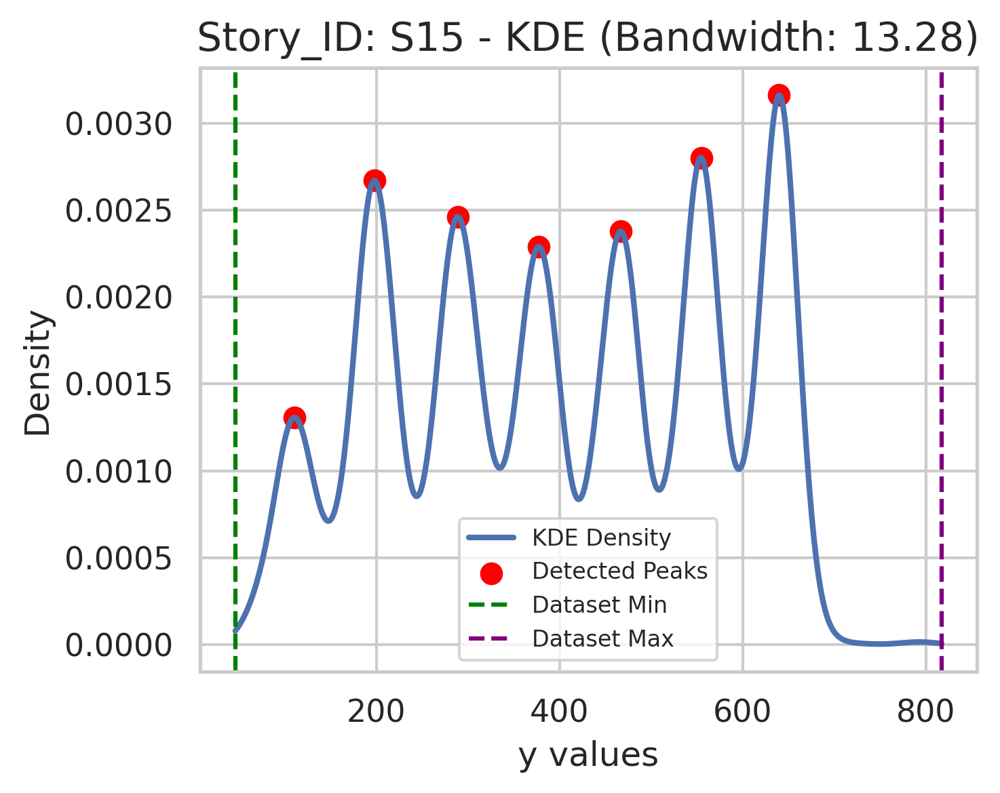

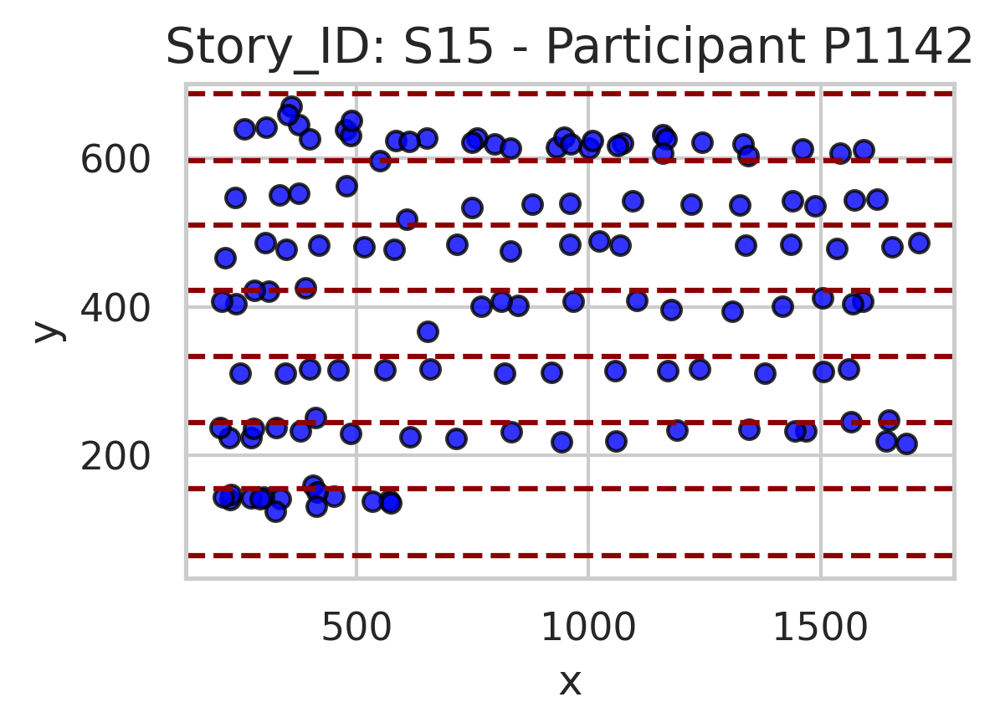

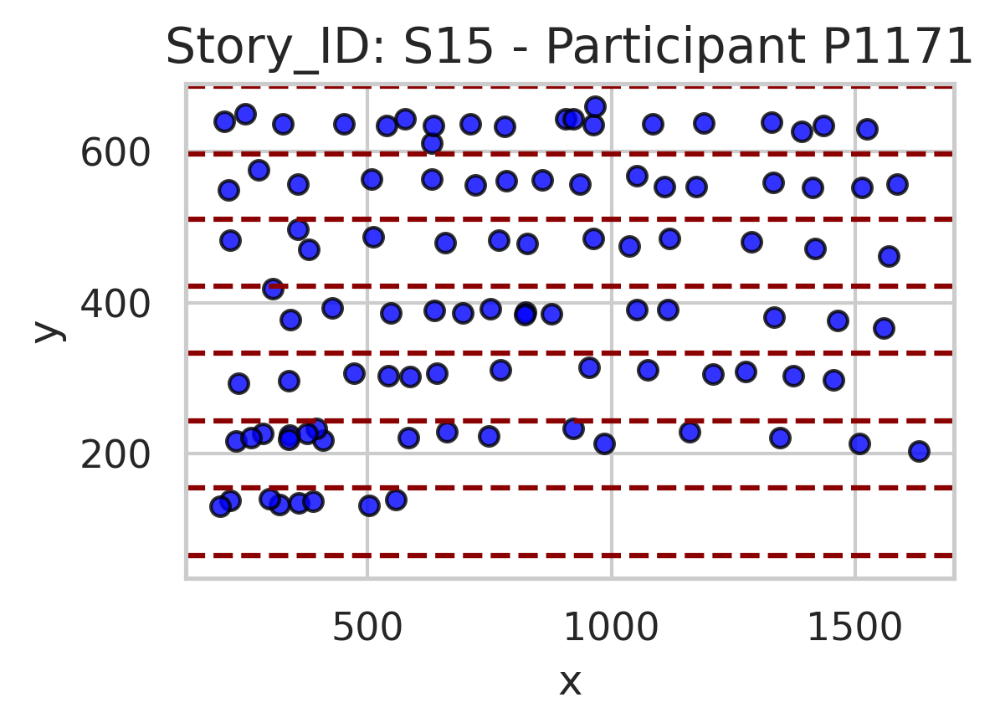

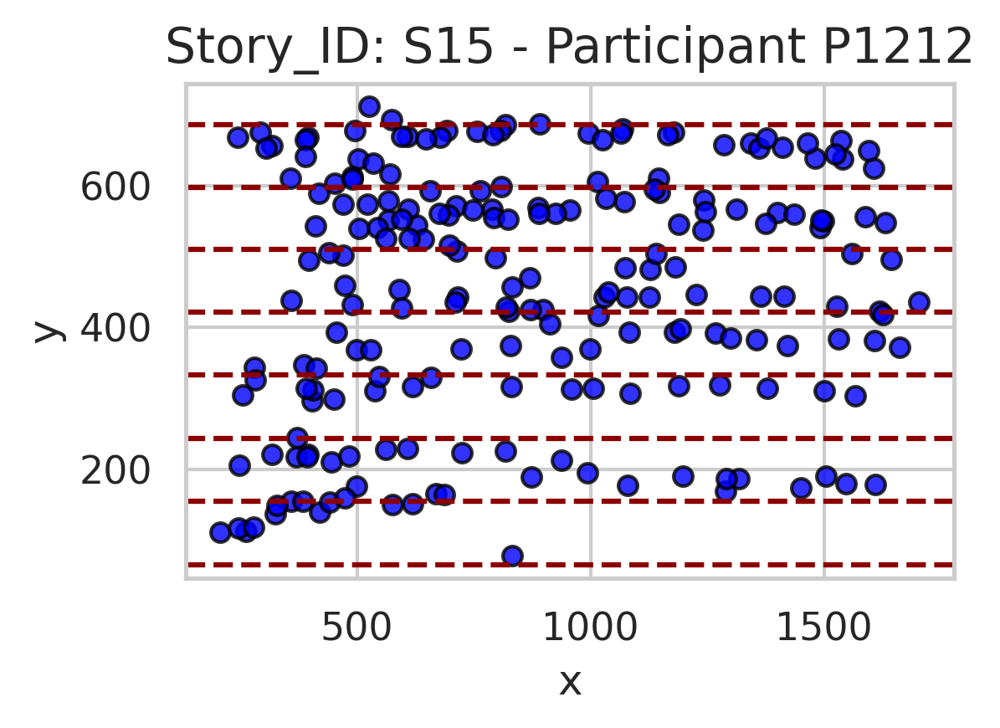

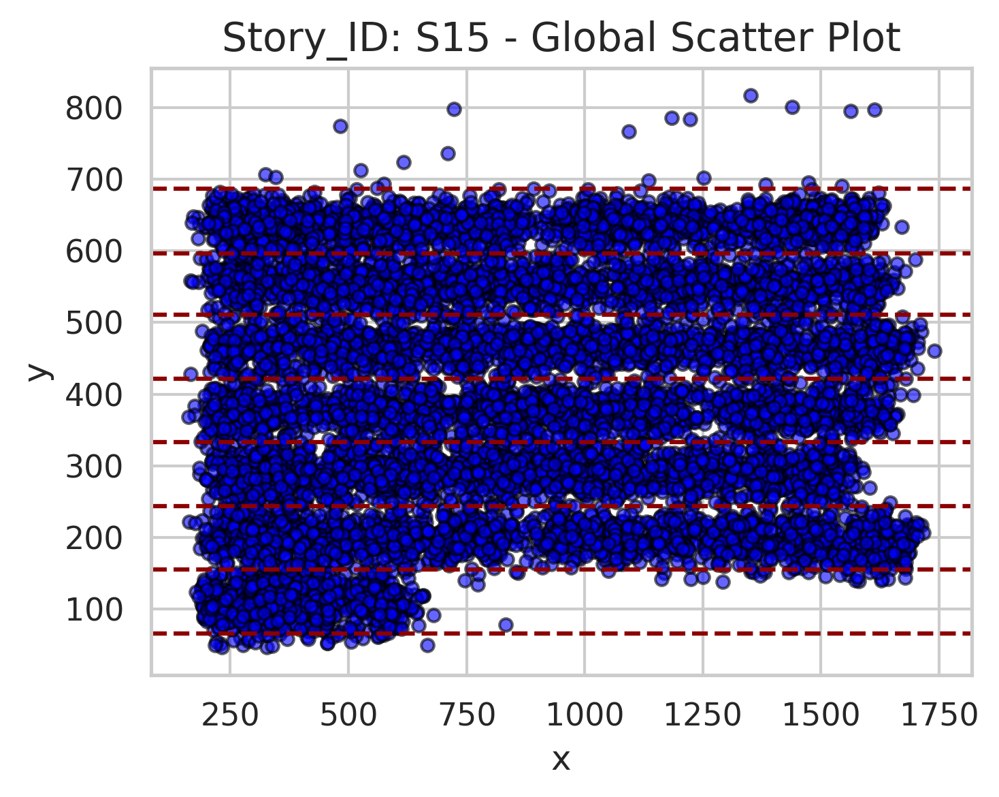

In [ ]:
# -----------------------------------------------------------
# 1. Library Imports and Google Drive Mounting
# -----------------------------------------------------------
from google.colab import drive
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import find_peaks
from scipy.stats import iqr
from sklearn.neighbors import KernelDensity

sns.set(style="whitegrid")
plt.rcParams.update({
    "font.size": 10,
    "axes.labelsize": 12,
    "axes.titlesize": 14,
    "figure.dpi": 300,
    "savefig.dpi": 300,
    "legend.fontsize": 8,
})

drive.mount('/content/drive', force_remount=True)
file_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/all_trials_merged.csv"

# -----------------------------------------------------------
# 2. Outlier Detection
# -----------------------------------------------------------
def detect_outliers_iqr(y_values, threshold=1.5):
    q1 = np.percentile(y_values, 25)
    q3 = np.percentile(y_values, 75)
    iqr_value = q3 - q1
    lower_bound = q1 - threshold * iqr_value
    upper_bound = q3 + threshold * iqr_value
    return (y_values < lower_bound) | (y_values > upper_bound)

# -----------------------------------------------------------
# 3. KDE-based Binning
# -----------------------------------------------------------
def hybrid_kde_binning(y_values, min_required_bins=2, story_info=""):
    print("\n--- Binning Summary ---")
    print(f"Full y-range: min = {y_values.min():.2f}, max = {y_values.max():.2f}")

    outliers = detect_outliers_iqr(y_values)
    n_outliers = np.sum(outliers)
    percent_outliers = (n_outliers / len(y_values)) * 100
    print(f"Detected outliers: {n_outliers} ({percent_outliers:.2f}%)")

    y_filtered = y_values[~outliers]
    print(f"Filtered y-range (without outliers): min = {y_filtered.min():.2f}, max = {y_filtered.max():.2f}")

    bandwidth = 0.5 * min(np.std(y_filtered), iqr(y_filtered)/1.34) * len(y_filtered)**(-1/5)
    kde = KernelDensity(bandwidth=bandwidth).fit(y_filtered.reshape(-1, 1))
    y_grid = np.linspace(y_filtered.min(), y_filtered.max(), 1000)
    density = np.exp(kde.score_samples(y_grid.reshape(-1, 1)))

    peaks, _ = find_peaks(density, prominence=0.01 * np.max(density))
    print(f"Number of detected peaks = {len(peaks)}")

    if len(peaks) >= min_required_bins:
        bin_centers = y_grid[peaks]
        print("Primary method: KDE peak detection")
    else:
        fallback_edges = np.percentile(y_filtered, np.linspace(0, 100, min_required_bins+1))
        bin_centers = (fallback_edges[:-1] + fallback_edges[1:]) / 2
        print("Fallback method: Percentile-based binning")

    if len(bin_centers) > 1:
        inner_edges = (bin_centers[:-1] + bin_centers[1:]) / 2
        spacings = np.diff(inner_edges)
        robust_spacing = np.mean(spacings) + 1 * np.std(spacings)
        lower_edge = inner_edges[0] - robust_spacing
        upper_edge = inner_edges[-1] + robust_spacing
        bin_edges = np.concatenate([[lower_edge], inner_edges, [upper_edge]])
    else:
        delta = np.std(y_filtered) if np.std(y_filtered) > 0 else 1.0
        bin_edges = np.array([bin_centers[0] - delta, bin_centers[0] + delta])

    num_bins = len(bin_edges) - 1
    print(f"Number of bins = {num_bins}")

    delta_y = np.diff(bin_edges)
    mean_delta = np.mean(delta_y)
    ratio = (np.max(delta_y) - np.min(delta_y)) / mean_delta if mean_delta != 0 else np.nan
    print(f"\u0394y Variability: {ratio:.2f} (Max-Min)/Mean")
    print(f"Final Bin Edges: {bin_edges}")
    print("-----------------------\n")

    fig, ax = plt.subplots(figsize=(5, 4))
    ax.plot(y_grid, density, label="KDE Density", linewidth=2)
    ax.scatter(y_grid[peaks], density[peaks], color="red", s=50, label="Detected Peaks")
    ax.axvline(y_values.min(), color='green', linestyle='--', linewidth=1.5, label="Dataset Min")
    ax.axvline(y_values.max(), color='purple', linestyle='--', linewidth=1.5, label="Dataset Max")
    title_text = f"{story_info} - KDE (Bandwidth: {bandwidth:.2f})" if story_info else f"KDE (Bandwidth: {bandwidth:.2f})"
    ax.set_title(title_text, fontsize=14)
    ax.set_xlabel("y values", fontsize=12)
    ax.set_ylabel("Density", fontsize=12)
    ax.legend(fontsize=8)
    plt.tight_layout()
    plt.savefig("Aggregated_KDE.pdf", bbox_inches="tight")
    plt.show()

    return bin_edges, outliers, ratio

# -----------------------------------------------------------
# 4. Scatter Plots with Bin Edges (No Centers, No Labels)
# -----------------------------------------------------------
def visualize_bins(df, global_y_bins, participant_ids, outliers, story_info=""):
    for pid in participant_ids:
        df_pid = df[df['Participant_ID'] == pid].copy()
        if df_pid.empty:
            continue

        fig, ax = plt.subplots(figsize=(4, 3))
        ax.scatter(df_pid['x'], df_pid['y'], c='blue', edgecolor='black', s=30, alpha=0.8)
        for edge in global_y_bins:
            ax.axhline(y=edge, color='darkred', linestyle='--', linewidth=1.5)

        title_text = f"{story_info} - Participant {pid}" if story_info else f"Participant {pid}"
        ax.set_title(title_text)
        ax.set_xlabel("x")
        ax.set_ylabel("y")
        plt.tight_layout()
        plt.savefig(f"Participant_{pid}_Scatter.pdf", bbox_inches="tight")
        plt.show()

    # Global scatter plot
    fig, ax = plt.subplots(figsize=(5, 4))
    ax.scatter(df['x'], df['y'], c='blue', edgecolor='black', s=20, alpha=0.6)
    for edge in global_y_bins:
        ax.axhline(y=edge, color='darkred', linestyle='--', linewidth=1.5)

    ax.set_title(f"{story_info} - Global Scatter Plot")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    plt.tight_layout()
    plt.savefig(f"Global_Scatter_{story_info}.pdf", bbox_inches="tight")
    plt.show()

# -----------------------------------------------------------
# 5. Data Loading and Execution
# -----------------------------------------------------------
def load_story_data(file_path, story_filter=None):
    df = pd.read_csv(file_path)
    if story_filter:
        df = df[df['Story'].str.contains(story_filter)]
    return df

if __name__ == "__main__":
    df = load_story_data(file_path, story_filter='-S15$')

    if 'Story' in df.columns and len(df) > 0:
        full_story = df['Story'].iloc[0]
        parts = full_story.split('-')
        if len(parts) >= 2:
            global_story_code = parts[1]
            story_info = f"Story_ID: {global_story_code}"
        else:
            story_info = full_story
    else:
        story_info = "Unknown Story"

    global_y_bins, outliers, ratio = hybrid_kde_binning(df['y'].values, story_info=story_info)
    visualize_bins(df, global_y_bins, df['Participant_ID'].unique()[:3], outliers, story_info=story_info)


Mounted at /content/drive
Summary table saved to CSV.


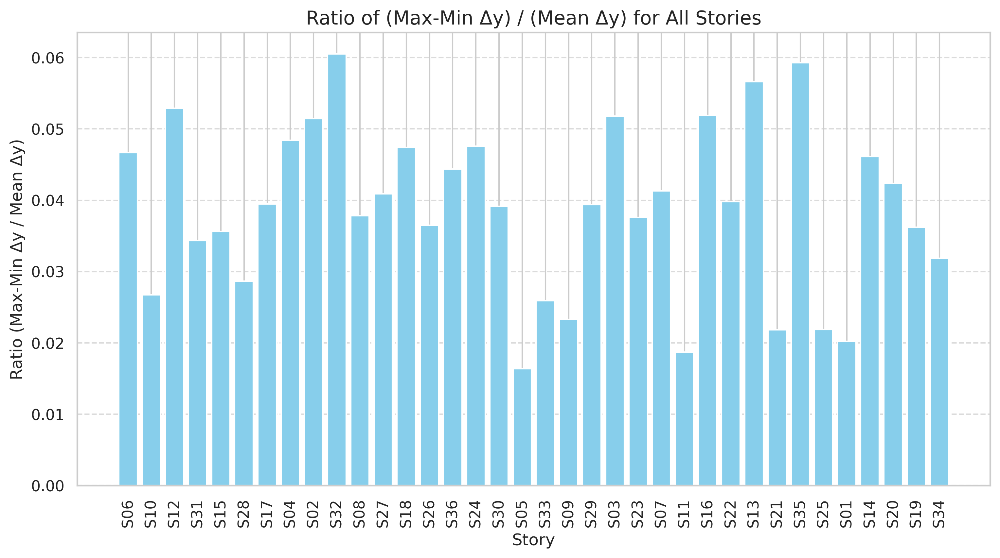

In [ ]:
# -----------------------------------------------------------
# 1. Library Imports and Google Drive Mounting
# -----------------------------------------------------------
from google.colab import drive
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import find_peaks, savgol_filter
from scipy.stats import iqr
from sklearn.neighbors import KernelDensity
from scipy.optimize import minimize_scalar

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)
file_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/all_trials_merged.csv"

# -----------------------------------------------------------
# 2. Outlier Detection
# -----------------------------------------------------------
def detect_outliers_iqr(y_values, threshold=1.5):
    q1 = np.percentile(y_values, 25)
    q3 = np.percentile(y_values, 75)
    iqr_value = q3 - q1
    lower_bound = q1 - threshold * iqr_value
    upper_bound = q3 + threshold * iqr_value
    outliers = (y_values < lower_bound) | (y_values > upper_bound)
    return outliers

# -----------------------------------------------------------
# 3. Core Binning Logic (Refined with Outlier Exclusion and Corrected Binning)
def hybrid_kde_binning(y_values, min_required_bins=2, max_cv=0.10):
    outliers = detect_outliers_iqr(y_values)
    y_filtered = y_values[~outliers]

    bandwidth = 0.5 * min(np.std(y_filtered), iqr(y_filtered) / 1.34) * len(y_filtered) ** (-1 / 5)
    kde = KernelDensity(bandwidth=bandwidth).fit(y_filtered.reshape(-1, 1))

    y_grid = np.linspace(y_filtered.min(), y_filtered.max(), 1000)
    log_density = kde.score_samples(y_grid.reshape(-1, 1))
    density = np.exp(log_density)

    peaks, _ = find_peaks(density, prominence=0.01 * np.max(density))

    if len(peaks) < min_required_bins:
        bin_centers = np.percentile(y_filtered, np.linspace(0, 100, min_required_bins + 2)[1:-1])
        method = "Percentile"
    else:
        bin_centers = y_grid[peaks]
        method = "KDE"

    # ----------- MODIFIED PART (single ± robust_spacing extension) ----------- #
    if len(bin_centers) > 1:
        interior_edges = (bin_centers[:-1] + bin_centers[1:]) / 2
        spacings = np.diff(interior_edges)
        robust_spacing = np.mean(spacings) + 1 * np.std(spacings)

        lower_edge = interior_edges[0] - robust_spacing
        upper_edge = interior_edges[-1] + robust_spacing

        bin_edges = np.concatenate([[lower_edge], interior_edges, [upper_edge]])
    else:
        delta = np.std(y_filtered) if np.std(y_filtered) > 0 else 1.0
        bin_edges = np.array([bin_centers[0] - delta, bin_centers[0] + delta])
    # ------------------------------------------------------------------------- #

    delta_y = np.diff(bin_edges)
    mean_delta = np.mean(delta_y)
    ratio = (np.max(delta_y) - np.min(delta_y)) / mean_delta if mean_delta != 0 else np.nan

    return bin_edges, bin_centers, outliers, method, len(bin_edges) - 1, ratio, y_grid, density, peaks



# -----------------------------------------------------------
# 4. Compute x-bins with fixed 15 bins
# -----------------------------------------------------------
def compute_x_bins(x_values, num_bins=15):
    return np.percentile(x_values, np.linspace(0, 100, num_bins + 1))

# -----------------------------------------------------------
# 5. Main Execution
# -----------------------------------------------------------
def load_story_data(file_path):
    df = pd.read_csv(file_path)
    return df

if __name__ == "__main__":
    df = load_story_data(file_path)

    df['Story_Number'] = df['Story'].str.extract(r'-S(\d+)$')

    summary_data = []
    kde_plots = []

    for story_number in df['Story_Number'].unique():
        if pd.isna(story_number) or story_number == "1":
            continue

        df_story = df[df['Story_Number'] == story_number]

        bin_edges, bin_centers, outliers, method, num_y_bins, ratio, y_grid, density, peaks = hybrid_kde_binning(df_story['y'].values)
        x_bins = compute_x_bins(df_story['x'].values, num_bins=15)

        summary_data.append({
            "Story": f"S{story_number}",
            "Number of Y-Bins": num_y_bins,
            "Method": method,
            "Max-Min/Mean Δy": ratio,
            "X-Bins": x_bins,
            "Bin Edges": bin_edges,
            "Bin Centers": bin_centers
        })

        kde_plots.append({
            "Story": f"S{story_number}",
            "y_grid": y_grid,
            "density": density,
            "peaks": peaks,
            "Bin Centers": bin_centers
        })

    summary_df = pd.DataFrame(summary_data)
    summary_df.to_csv("/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/summary_table.csv", index=False)
    print("Summary table saved to CSV.")

    num_stories = len(kde_plots)
    num_rows = (num_stories + 3) // 4
    fig, axes = plt.subplots(num_rows, 4, figsize=(20, 5 * num_rows))
    axes = axes.flatten()

    for i, plot_data in enumerate(kde_plots):
        ax = axes[i]
        ax.plot(plot_data["y_grid"], plot_data["density"], label="Probability Density")
        ax.scatter(plot_data["y_grid"][plot_data["peaks"]], plot_data["density"][plot_data["peaks"]],
                   color="red", label="Detected Peaks (Bin Centers)")
        ax.set_title(f"Story {plot_data['Story']}")
        ax.set_xlabel("y values")
        ax.set_ylabel("Probability Density")
        ax.legend()

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(12, 6))
    stories = summary_df["Story"]
    ratios = summary_df["Max-Min/Mean Δy"]

    plt.bar(stories, ratios, color='skyblue')
    plt.xlabel("Story")
    plt.ylabel("Ratio (Max-Min Δy / Mean Δy)")
    plt.title("Ratio of (Max-Min Δy) / (Mean Δy) for All Stories")
    plt.xticks(rotation=90)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()


Mounted at /content/drive

Processing story: S06
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.047
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S06               ADHD                   258.277227   
1       P1171  P1171-S06               ADHD                   204.996694   
2       P1212  P1212-S06                 TD                   536.835827   
3       P1379  P1379-S06               ADHD                   180.277789   
4       P1433  P1433-S06                 TD                   211.133668   
..        ...        ...                ...                          ...   
89      P9691  P9691-S06                 TD                   368.219988   
90      P9707  P9707-S06                 TD                   254.255717   
91      P9810  P9810-S06               ADHD                   282.509559   
92      P9881  P9881-S06               ADHD                   657.924822   
93      P990

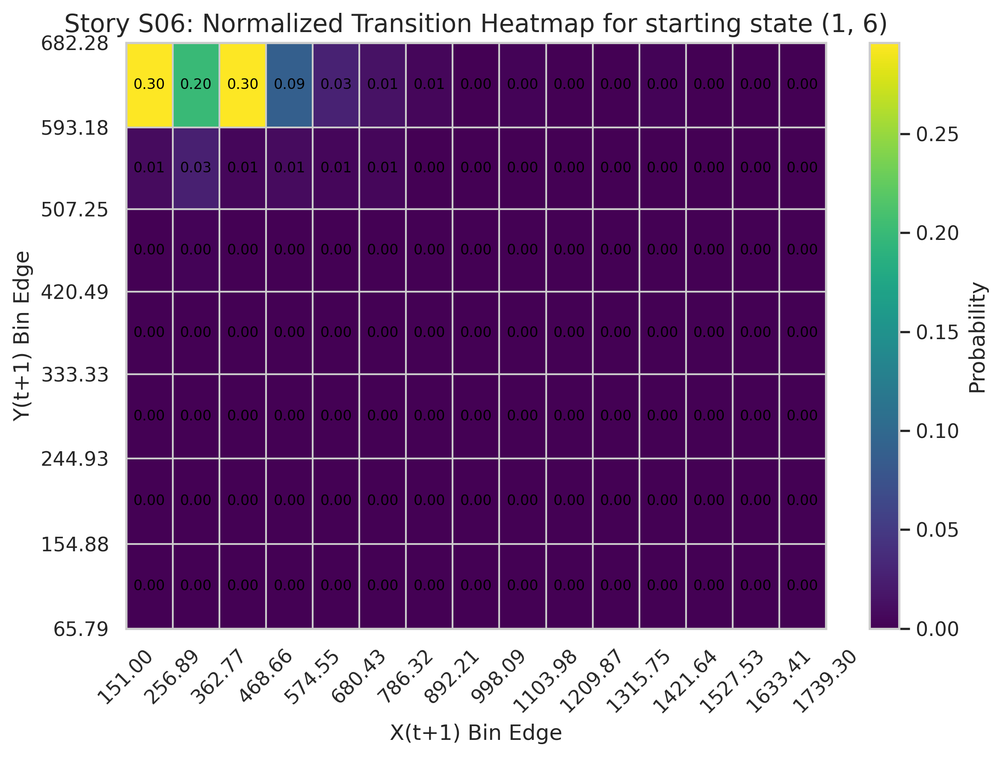


Processing story: S10
Binning method: KDE, Number of Y-Bins: 6, Δy Ratio: 0.027
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S10               ADHD                   207.898525   
1       P1171  P1171-S10               ADHD                    85.627076   
2       P1379  P1379-S10               ADHD                   152.702233   
3       P1433  P1433-S10                 TD                   307.200311   
4       P1475  P1475-S10                 TD                   218.206335   
..        ...        ...                ...                          ...   
88      P9687  P9687-S10               ADHD                   192.169680   
89      P9691  P9691-S10                 TD                   325.062940   
90      P9707  P9707-S10                 TD                   314.029131   
91      P9810  P9810-S10               ADHD                   217.951313   
92      P9909  P9909-S10              

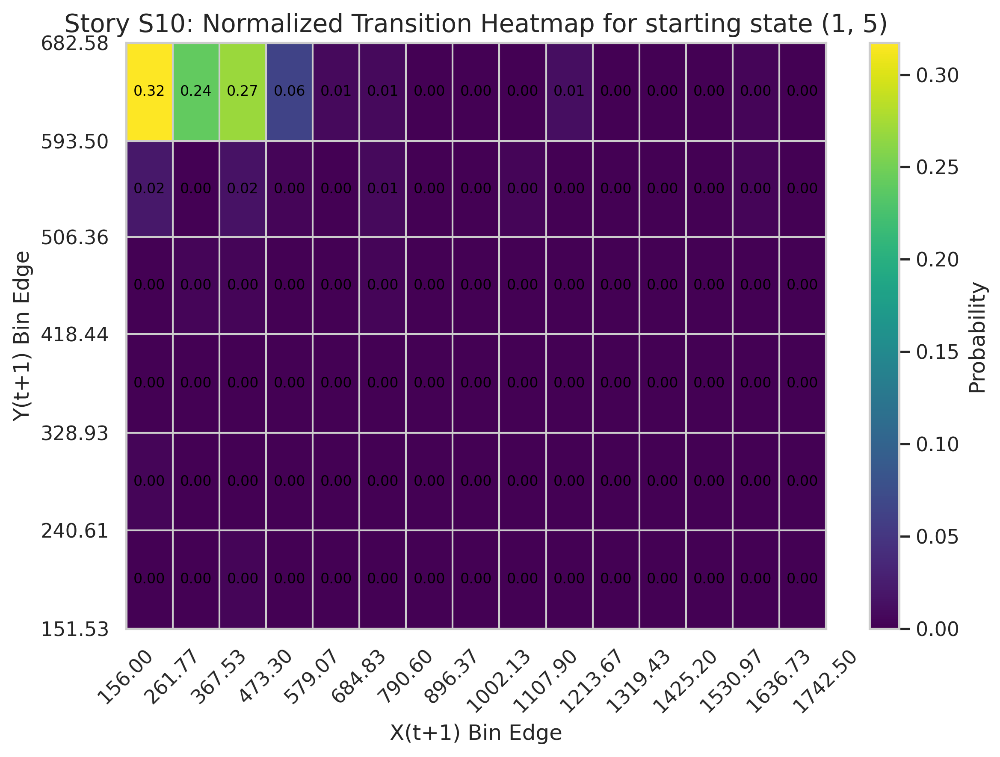


Processing story: S12
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.053
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S12               ADHD                   297.383467   
1       P1171  P1171-S12               ADHD                    86.434472   
2       P1212  P1212-S12                 TD                   742.875495   
3       P1379  P1379-S12               ADHD                   226.774865   
4       P1433  P1433-S12                 TD                   133.416242   
..        ...        ...                ...                          ...   
93      P9687  P9687-S12               ADHD                   420.197760   
94      P9691  P9691-S12                 TD                   349.688241   
95      P9707  P9707-S12                 TD                   205.299977   
96      P9810  P9810-S12               ADHD                   121.446493   
97      P9909  P9909-S12              

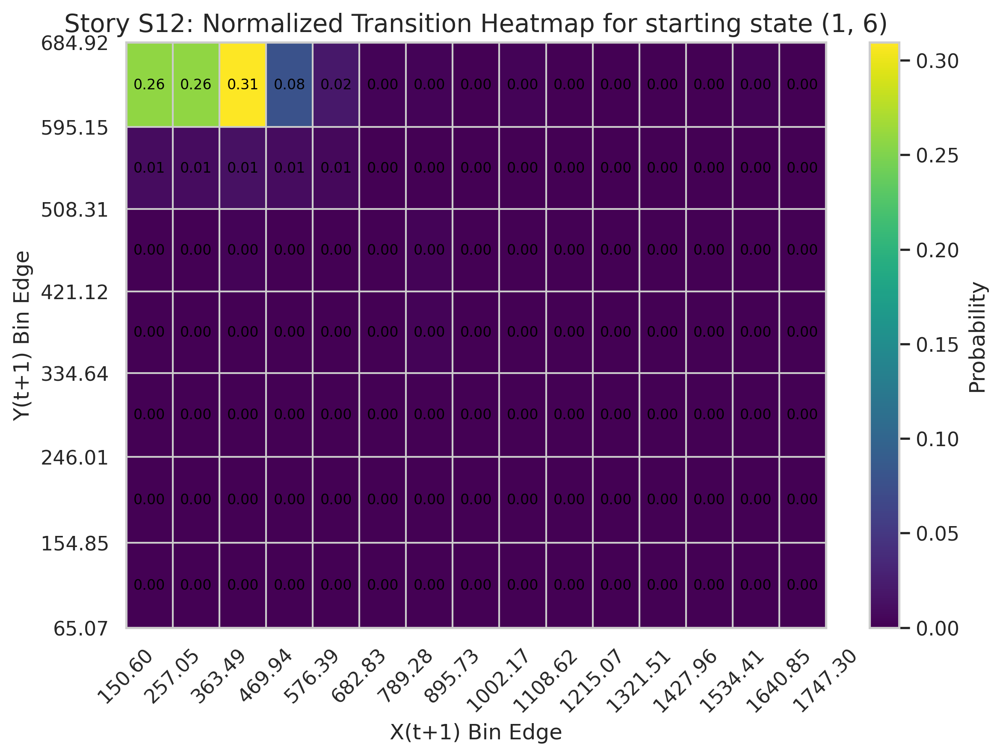


Processing story: S31
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.034
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S31               ADHD                   199.255805   
1       P1171  P1171-S31               ADHD                    86.543535   
2       P1212  P1212-S31                 TD                   473.995788   
3       P1379  P1379-S31               ADHD                   292.605939   
4       P1433  P1433-S31                 TD                   123.434879   
..        ...        ...                ...                          ...   
92      P9691  P9691-S31                 TD                   159.398015   
93      P9707  P9707-S31                 TD                   139.685891   
94      P9810  P9810-S31               ADHD                   273.228194   
95      P9881  P9881-S31               ADHD                   718.426517   
96      P9909  P9909-S31              

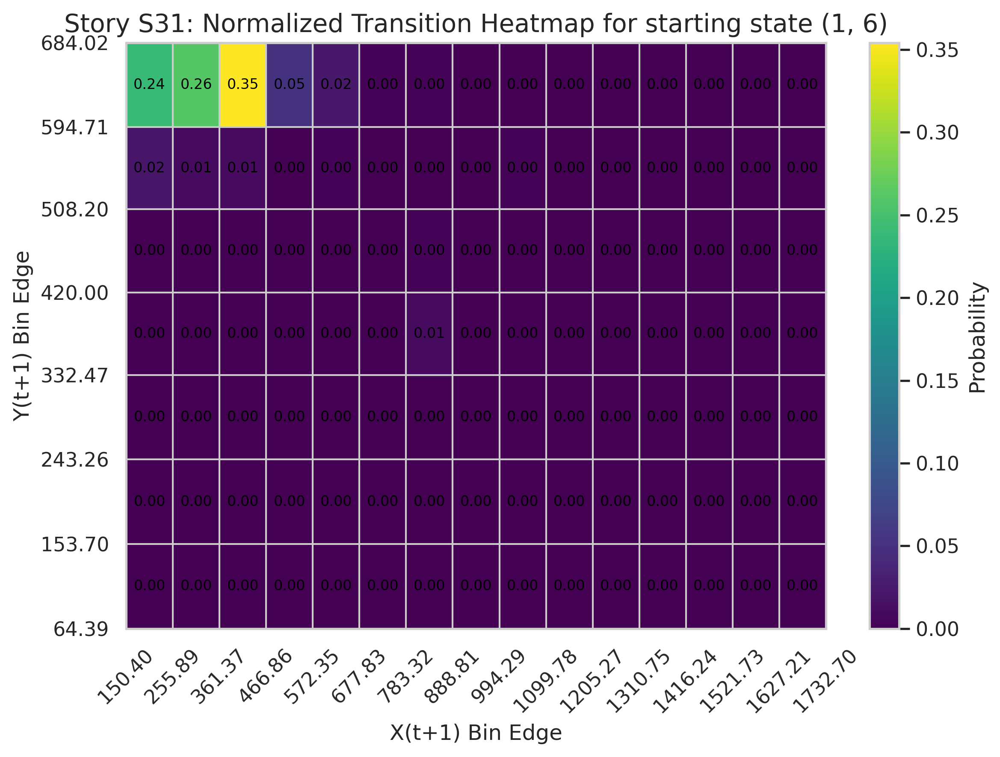


Processing story: S15
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.036
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S15               ADHD                   563.104370   
1       P1171  P1171-S15               ADHD                   152.208475   
2       P1212  P1212-S15                 TD                   648.027685   
3       P1379  P1379-S15               ADHD                   168.341165   
4       P1433  P1433-S15                 TD                   143.385870   
..        ...        ...                ...                          ...   
91      P9691  P9691-S15                 TD                   208.628989   
92      P9707  P9707-S15                 TD                   187.066785   
93      P9810  P9810-S15               ADHD                   817.121624   
94      P9881  P9881-S15               ADHD                   556.107236   
95      P9909  P9909-S15              

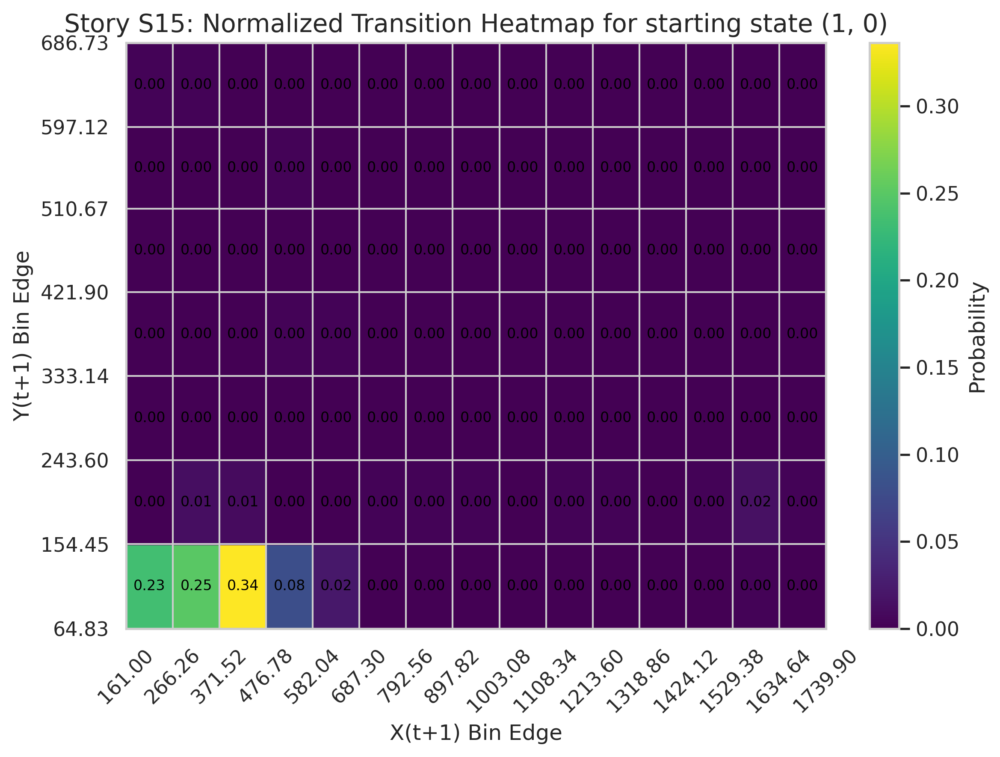


Processing story: S28
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.029
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S28               ADHD                   356.122722   
1       P1171  P1171-S28               ADHD                    85.347416   
2       P1212  P1212-S28                 TD                   606.313524   
3       P1379  P1379-S28               ADHD                   207.452294   
4       P1433  P1433-S28                 TD                   466.727897   
..        ...        ...                ...                          ...   
92      P9687  P9687-S28               ADHD                   107.758373   
93      P9691  P9691-S28                 TD                   440.691664   
94      P9707  P9707-S28                 TD                   276.852402   
95      P9810  P9810-S28               ADHD                   492.673658   
96      P9909  P9909-S28              

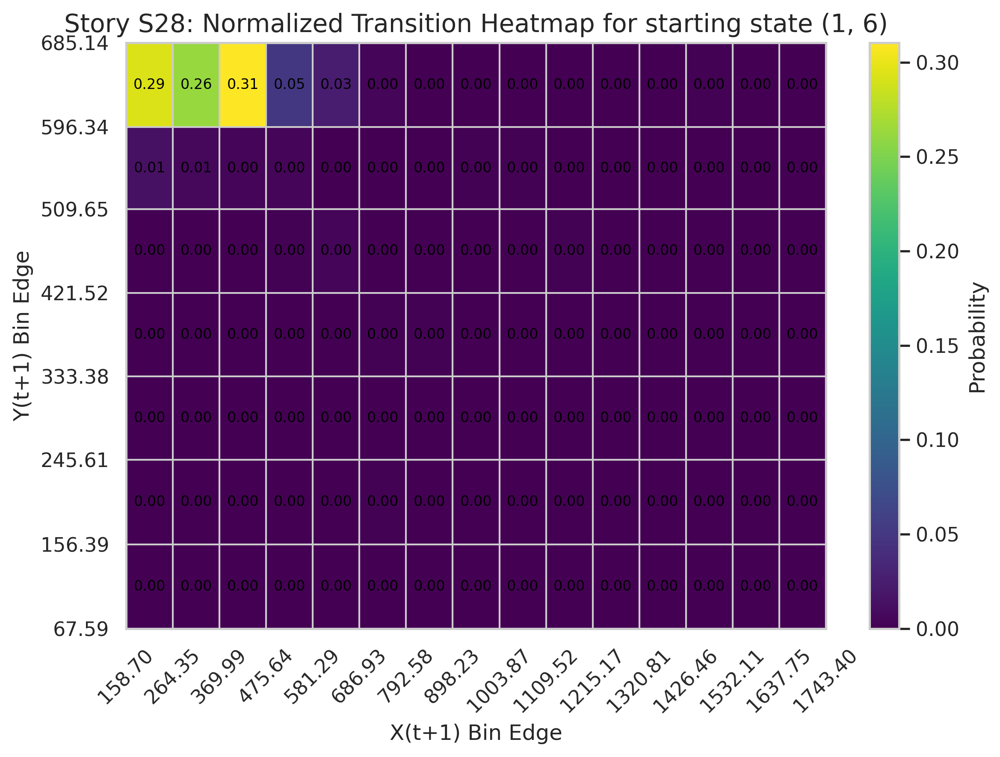


Processing story: S17
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.039
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S17               ADHD                   318.792435   
1       P1171  P1171-S17               ADHD                   204.821826   
2       P1212  P1212-S17                 TD                   466.050413   
3       P1379  P1379-S17               ADHD                  1077.418796   
4       P1433  P1433-S17                 TD                   126.541702   
..        ...        ...                ...                          ...   
92      P9691  P9691-S17                 TD                  1051.400236   
93      P9707  P9707-S17                 TD                   297.871707   
94      P9810  P9810-S17               ADHD                   688.493301   
95      P9881  P9881-S17               ADHD                   678.804810   
96      P9909  P9909-S17              

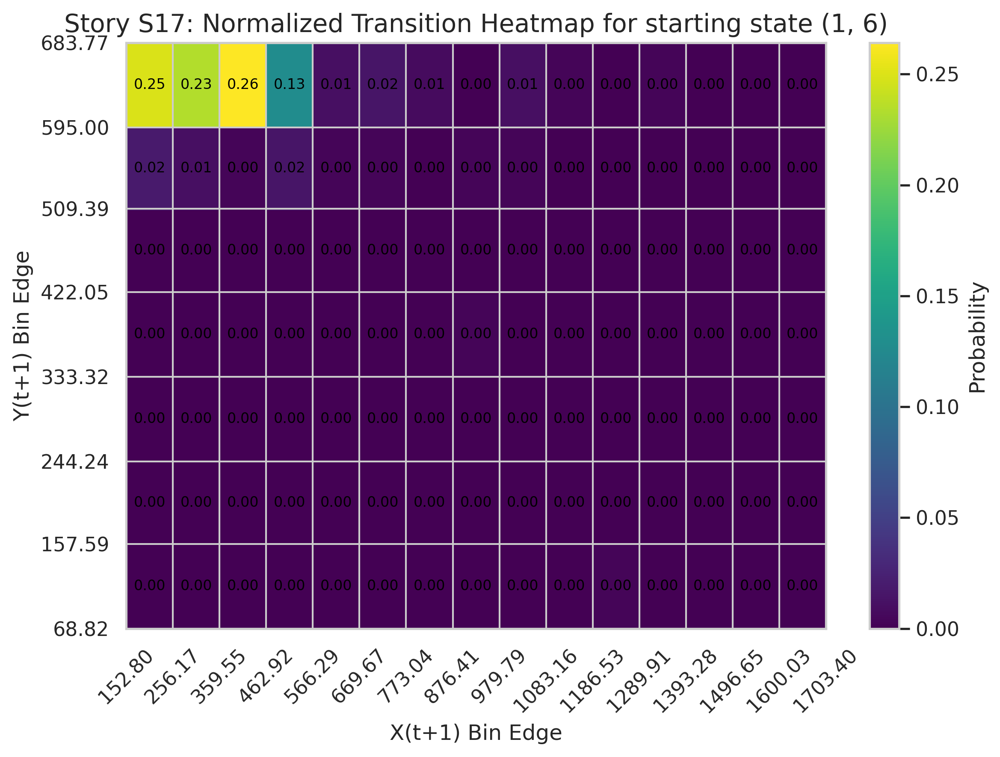


Processing story: S04
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.048
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S04               ADHD                   455.070004   
1       P1171  P1171-S04               ADHD                   110.668957   
2       P1212  P1212-S04                 TD                   559.682469   
3       P1379  P1379-S04               ADHD                   153.964114   
4       P1433  P1433-S04                 TD                   308.055122   
..        ...        ...                ...                          ...   
91      P9691  P9691-S04                 TD                   236.949094   
92      P9707  P9707-S04                 TD                   114.706777   
93      P9810  P9810-S04               ADHD                   234.614679   
94      P9881  P9881-S04               ADHD                   552.753628   
95      P9909  P9909-S04              

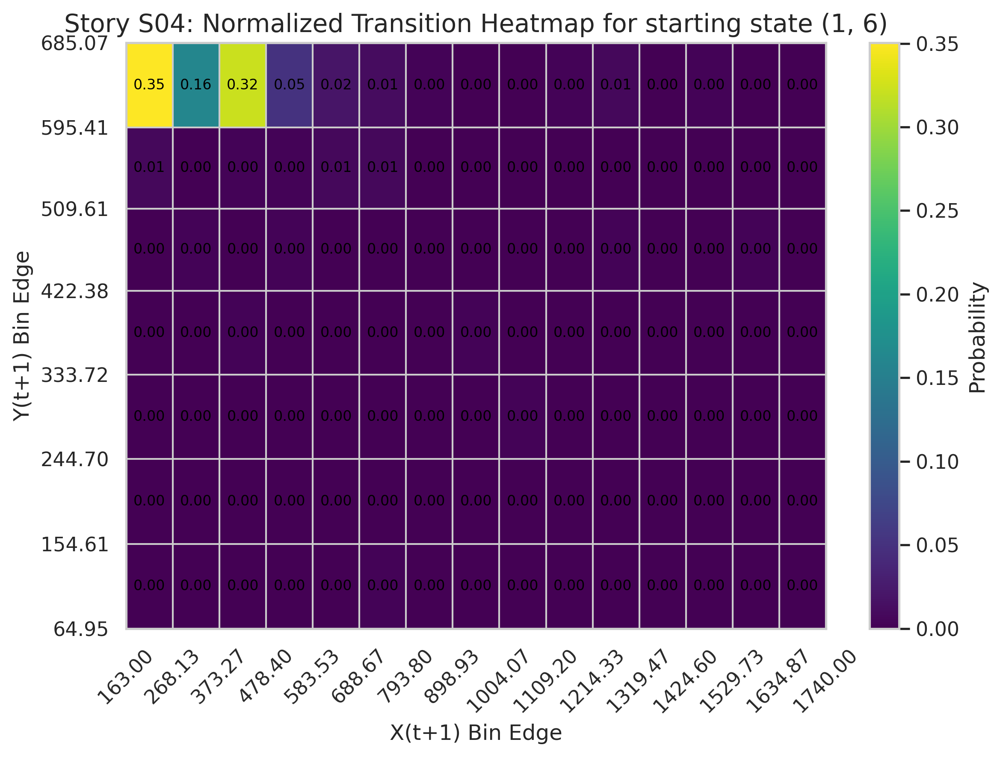


Processing story: S02
Binning method: KDE, Number of Y-Bins: 6, Δy Ratio: 0.051
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S02               ADHD                   395.529721   
1       P1171  P1171-S02               ADHD                   304.487161   
2       P1212  P1212-S02                 TD                   710.904717   
3       P1379  P1379-S02               ADHD                   266.871309   
4       P1433  P1433-S02                 TD                   389.179294   
..        ...        ...                ...                          ...   
89      P9691  P9691-S02                 TD                   478.970115   
90      P9707  P9707-S02                 TD                   216.529826   
91      P9810  P9810-S02               ADHD                   312.329221   
92      P9881  P9881-S02               ADHD                   357.386002   
93      P9909  P9909-S02              

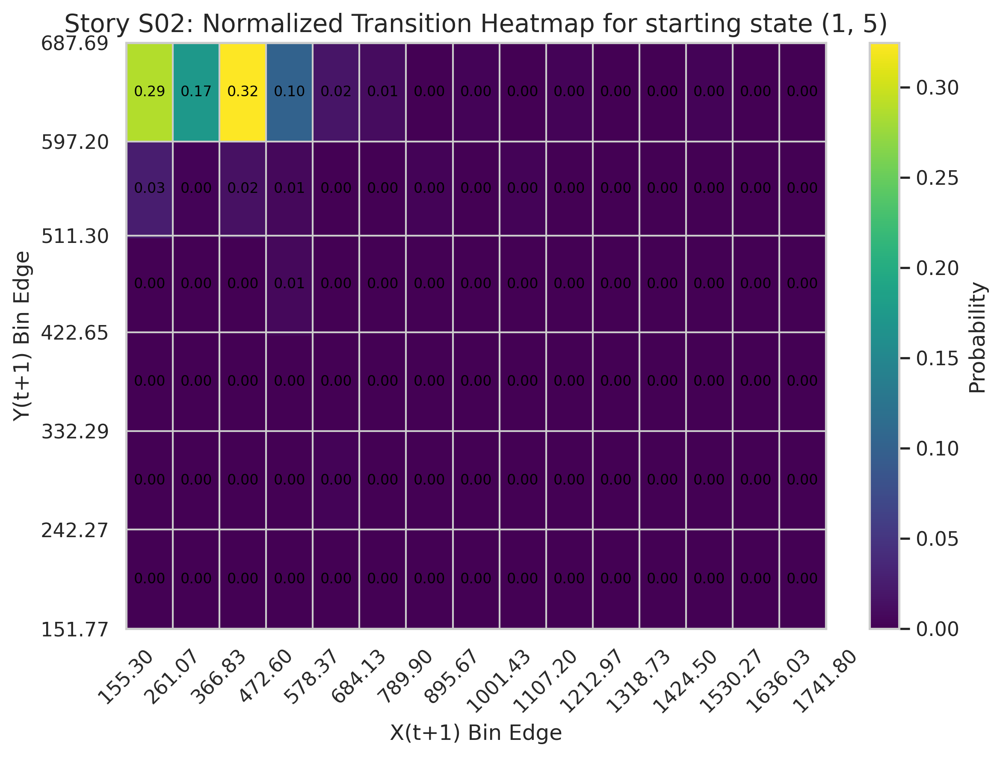


Processing story: S32
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.060
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S32               ADHD                  1054.138094   
1       P1171  P1171-S32               ADHD                   128.605709   
2       P1212  P1212-S32                 TD                   548.927619   
3       P1379  P1379-S32               ADHD                   221.137500   
4       P1433  P1433-S32                 TD                   403.732343   
..        ...        ...                ...                          ...   
90      P9691  P9691-S32                 TD                   266.997271   
91      P9707  P9707-S32                 TD                   197.042915   
92      P9810  P9810-S32               ADHD                   112.232473   
93      P9881  P9881-S32               ADHD                   165.123140   
94      P9909  P9909-S32              

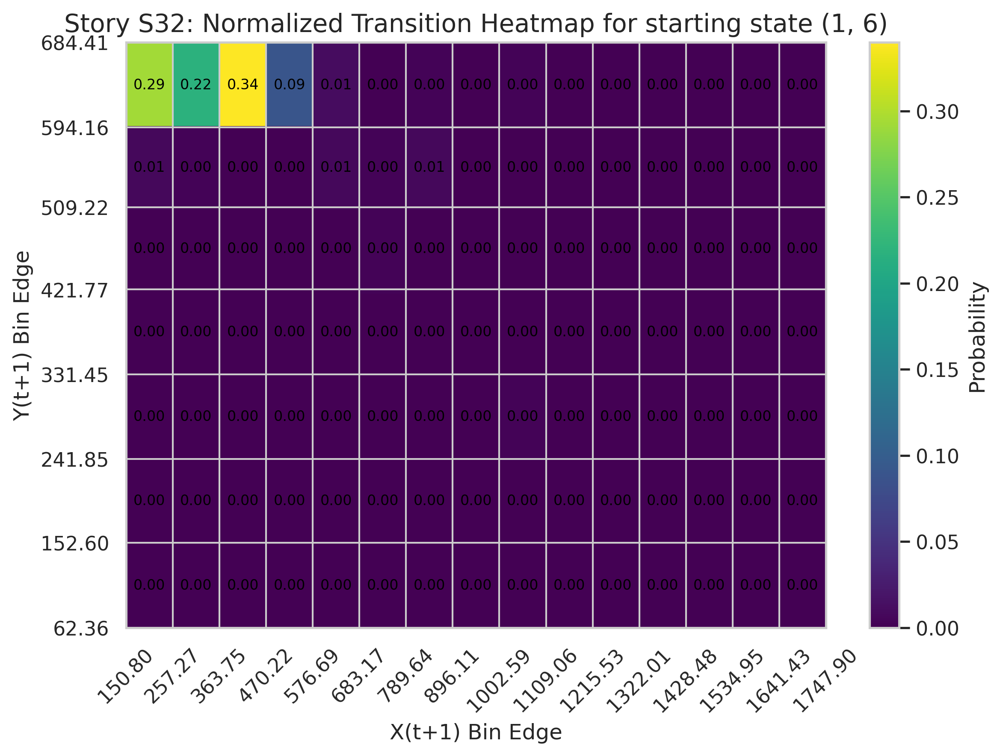


Processing story: S08
Binning method: KDE, Number of Y-Bins: 8, Δy Ratio: 0.038
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S08               ADHD                   423.964339   
1       P1171  P1171-S08               ADHD                    94.519633   
2       P1212  P1212-S08                 TD                   304.154468   
3       P1379  P1379-S08               ADHD                   199.529731   
4       P1475  P1475-S08                 TD                   398.426858   
..        ...        ...                ...                          ...   
89      P9691  P9691-S08                 TD                   322.247177   
90      P9707  P9707-S08                 TD                   187.418861   
91      P9810  P9810-S08               ADHD                   173.105139   
92      P9881  P9881-S08               ADHD                   837.130855   
93      P9909  P9909-S08              

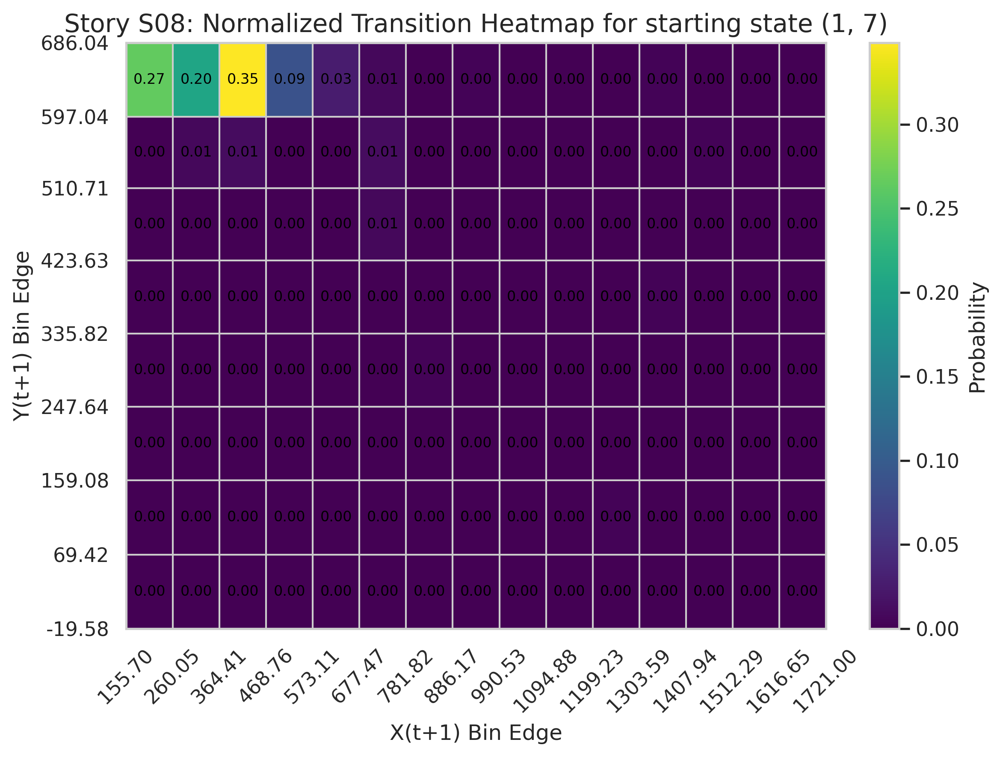


Processing story: S27
Binning method: KDE, Number of Y-Bins: 6, Δy Ratio: 0.041
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S27               ADHD                   783.492244   
1       P1171  P1171-S27               ADHD                   121.998844   
2       P1212  P1212-S27                 TD                   652.677293   
3       P1379  P1379-S27               ADHD                    99.463339   
4       P1433  P1433-S27                 TD                   108.497303   
..        ...        ...                ...                          ...   
91      P9691  P9691-S27                 TD                   274.697535   
92      P9707  P9707-S27                 TD                   131.343618   
93      P9810  P9810-S27               ADHD                   379.174986   
94      P9881  P9881-S27               ADHD                   603.875157   
95      P9909  P9909-S27              

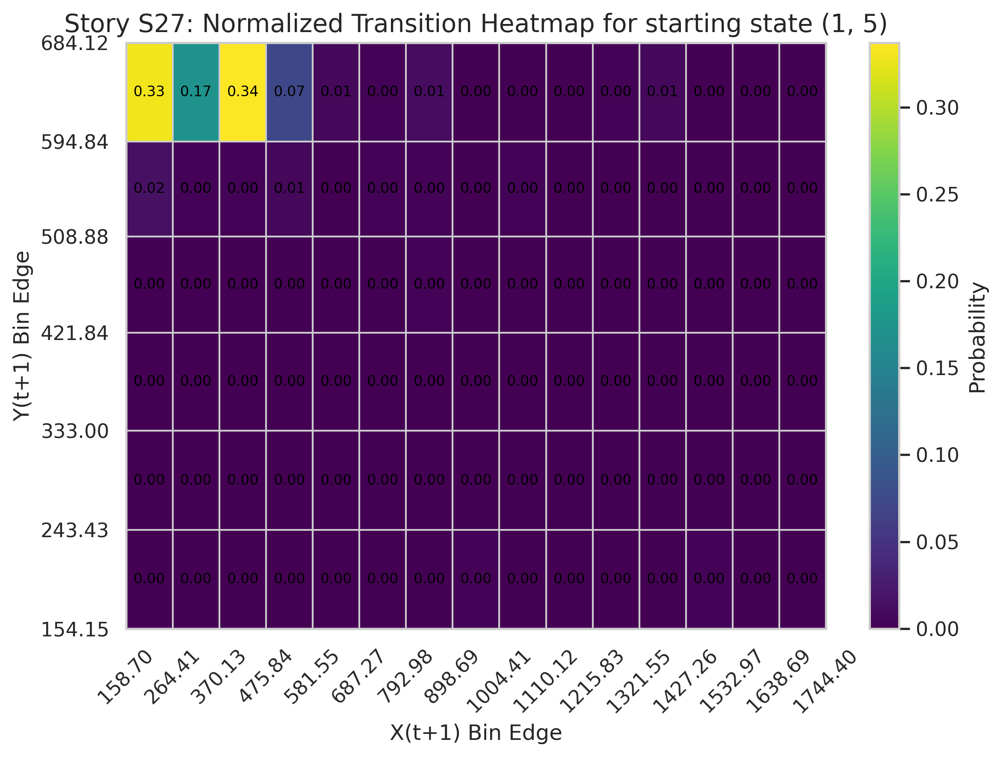


Processing story: S18
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.047
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S18               ADHD                   935.698553   
1       P1171  P1171-S18               ADHD                   149.487571   
2       P1212  P1212-S18                 TD                   562.307726   
3       P1379  P1379-S18               ADHD                   106.393075   
4       P1433  P1433-S18                 TD                   133.130320   
..        ...        ...                ...                          ...   
90      P9687  P9687-S18               ADHD                   156.533749   
91      P9691  P9691-S18                 TD                   383.477829   
92      P9707  P9707-S18                 TD                   223.328148   
93      P9810  P9810-S18               ADHD                   225.987344   
94      P9909  P9909-S18              

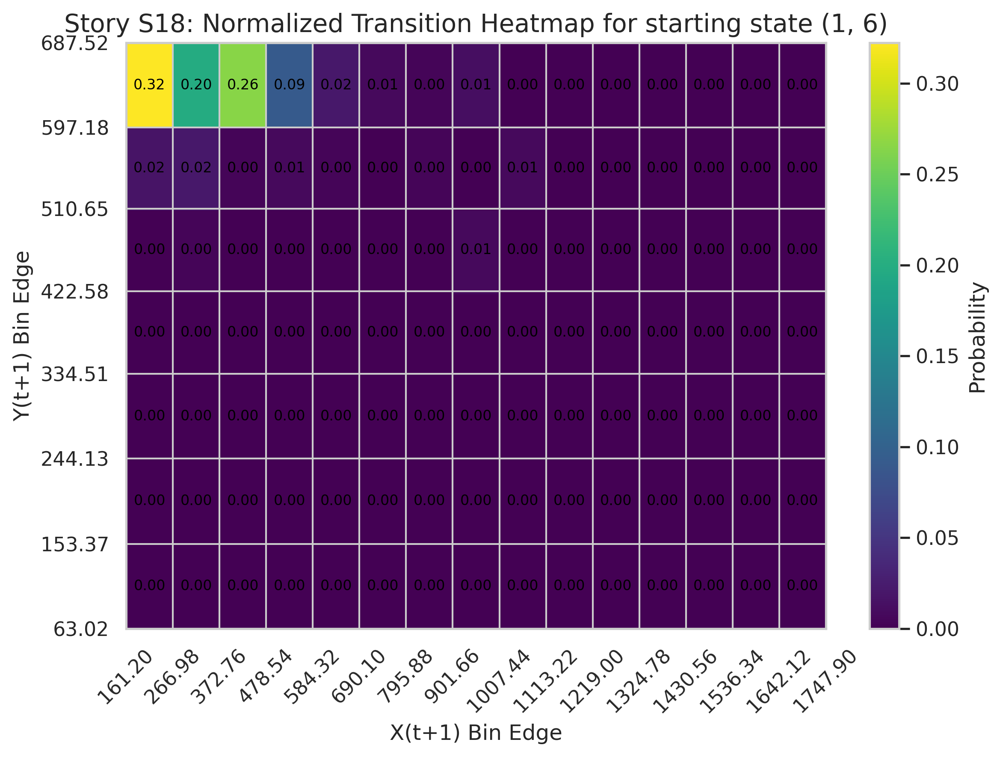


Processing story: S26
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.036
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S26               ADHD                   271.762916   
1       P1171  P1171-S26               ADHD                   147.085504   
2       P1212  P1212-S26                 TD                   415.288963   
3       P1379  P1379-S26               ADHD                   167.887903   
4       P1433  P1433-S26                 TD                   893.937746   
..        ...        ...                ...                          ...   
88      P9691  P9691-S26                 TD                   187.695085   
89      P9707  P9707-S26                 TD                   243.248114   
90      P9810  P9810-S26               ADHD                   105.536082   
91      P9881  P9881-S26               ADHD                   636.840188   
92      P9909  P9909-S26              

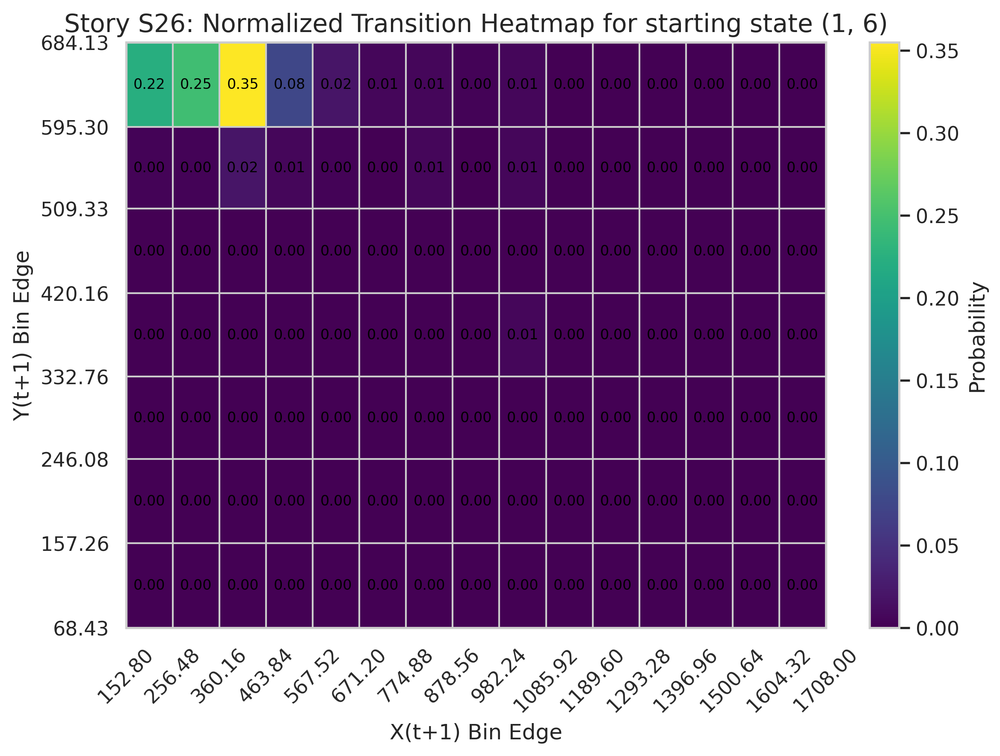


Processing story: S36
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.044
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S36               ADHD                   222.643876   
1       P1171  P1171-S36               ADHD                   161.030421   
2       P1212  P1212-S36                 TD                   458.564768   
3       P1433  P1433-S36                 TD                   111.165729   
4       P1475  P1475-S36                 TD                   225.121889   
..        ...        ...                ...                          ...   
90      P9687  P9687-S36               ADHD                   223.688031   
91      P9691  P9691-S36                 TD                   457.523275   
92      P9707  P9707-S36                 TD                   188.651209   
93      P9810  P9810-S36               ADHD                    93.718125   
94      P9909  P9909-S36              

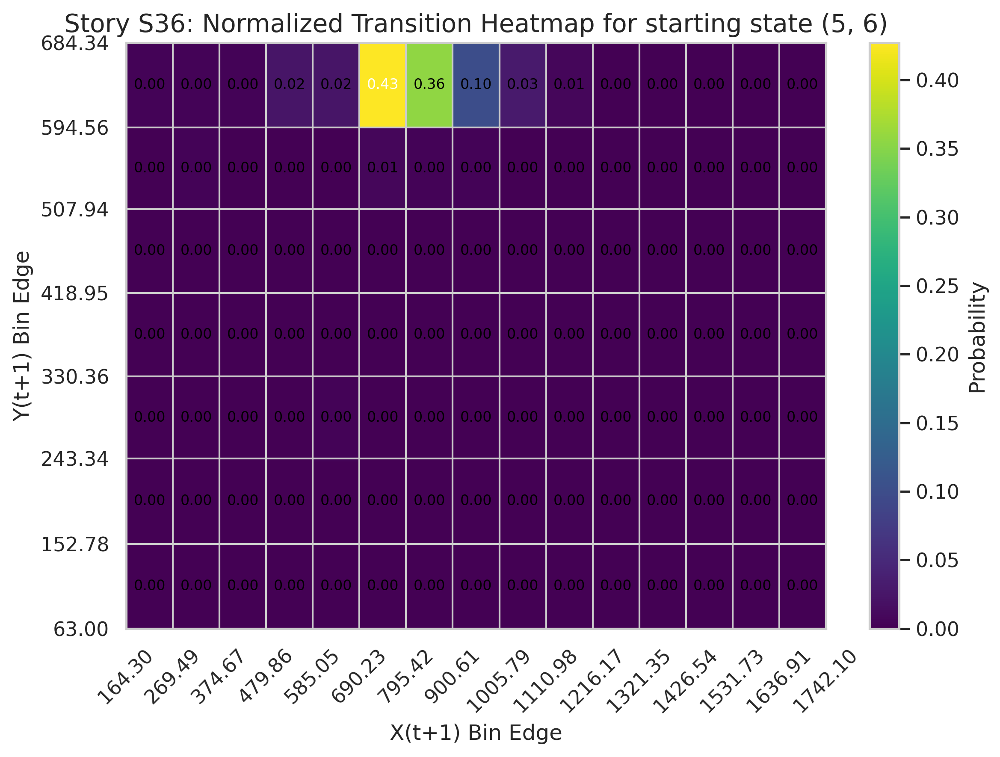


Processing story: S24
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.048
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S24               ADHD                   430.918434   
1       P1171  P1171-S24               ADHD                    99.173803   
2       P1212  P1212-S24                 TD                   485.885249   
3       P1379  P1379-S24               ADHD                   430.977264   
4       P1433  P1433-S24                 TD                   125.664182   
..        ...        ...                ...                          ...   
93      P9691  P9691-S24                 TD                   227.440370   
94      P9707  P9707-S24                 TD                   168.098753   
95      P9810  P9810-S24               ADHD                   284.029349   
96      P9881  P9881-S24               ADHD                   215.352822   
97      P9909  P9909-S24              

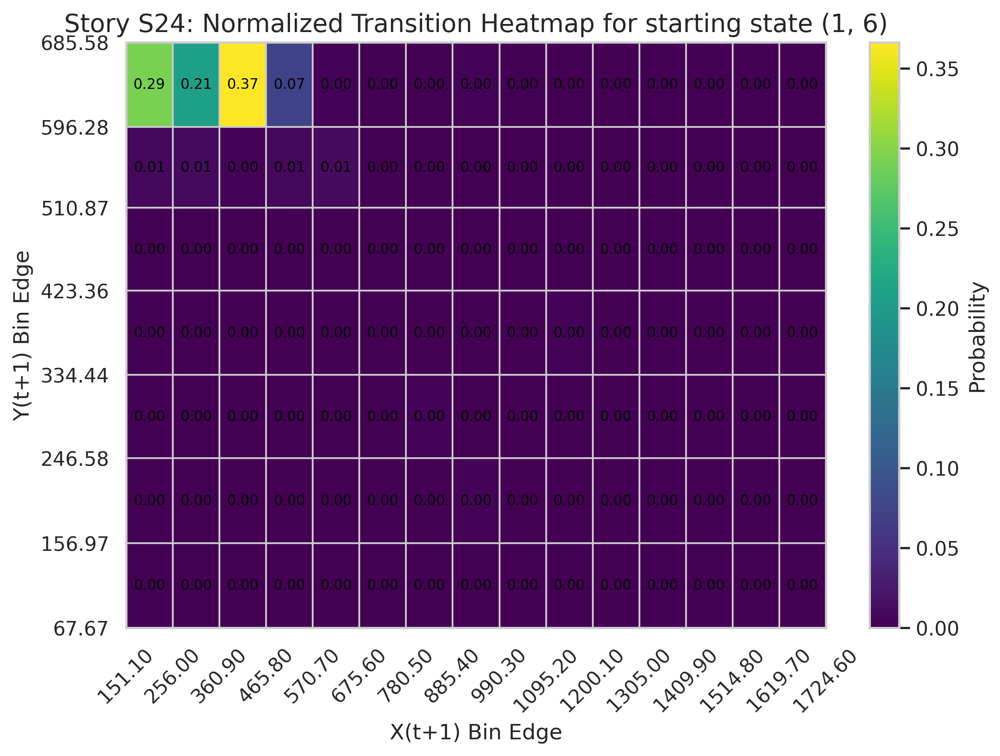


Processing story: S30
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.039
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S30               ADHD                   432.417814   
1       P1171  P1171-S30               ADHD                   322.362063   
2       P1212  P1212-S30                 TD                   660.227522   
3       P1379  P1379-S30               ADHD                   269.396076   
4       P1433  P1433-S30                 TD                   128.121210   
..        ...        ...                ...                          ...   
92      P9687  P9687-S30               ADHD                   446.738822   
93      P9691  P9691-S30                 TD                   296.592654   
94      P9707  P9707-S30                 TD                   156.975506   
95      P9810  P9810-S30               ADHD                   313.787027   
96      P9909  P9909-S30              

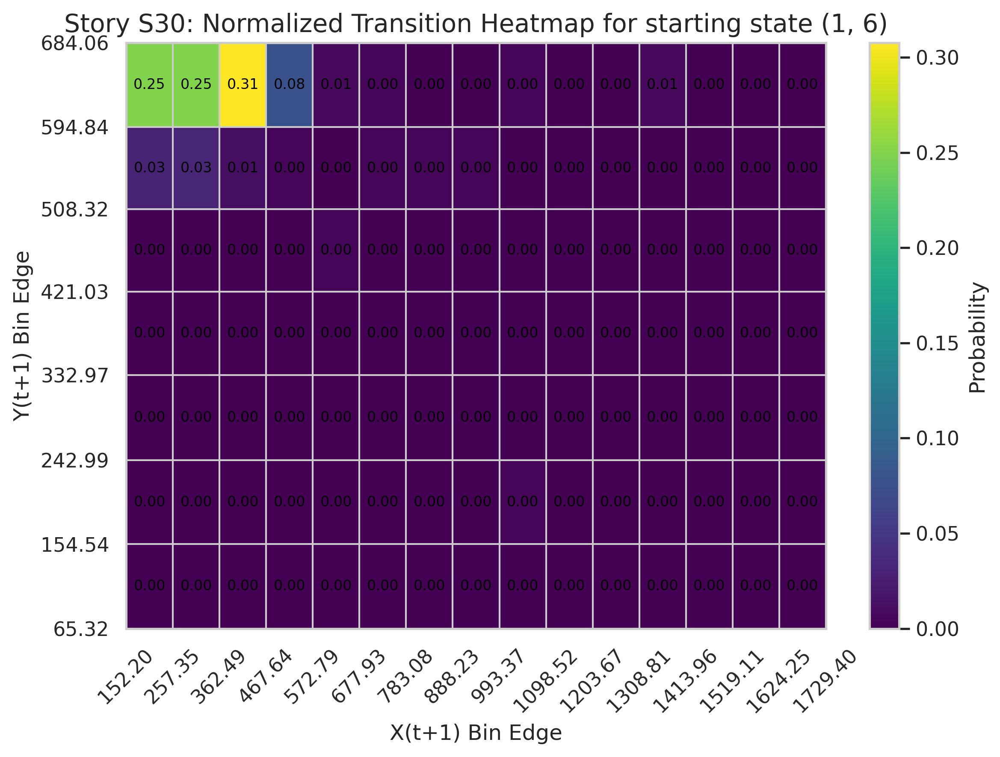


Processing story: S05
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.016
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S05               ADHD                   236.648677   
1       P1171  P1171-S05               ADHD                    81.047724   
2       P1212  P1212-S05                 TD                   864.109135   
3       P1379  P1379-S05               ADHD                   851.848326   
4       P1433  P1433-S05                 TD                   259.017596   
..        ...        ...                ...                          ...   
91      P9687  P9687-S05               ADHD                   161.482454   
92      P9691  P9691-S05                 TD                   466.305379   
93      P9707  P9707-S05                 TD                   196.533350   
94      P9810  P9810-S05               ADHD                   246.893928   
95      P9909  P9909-S05              

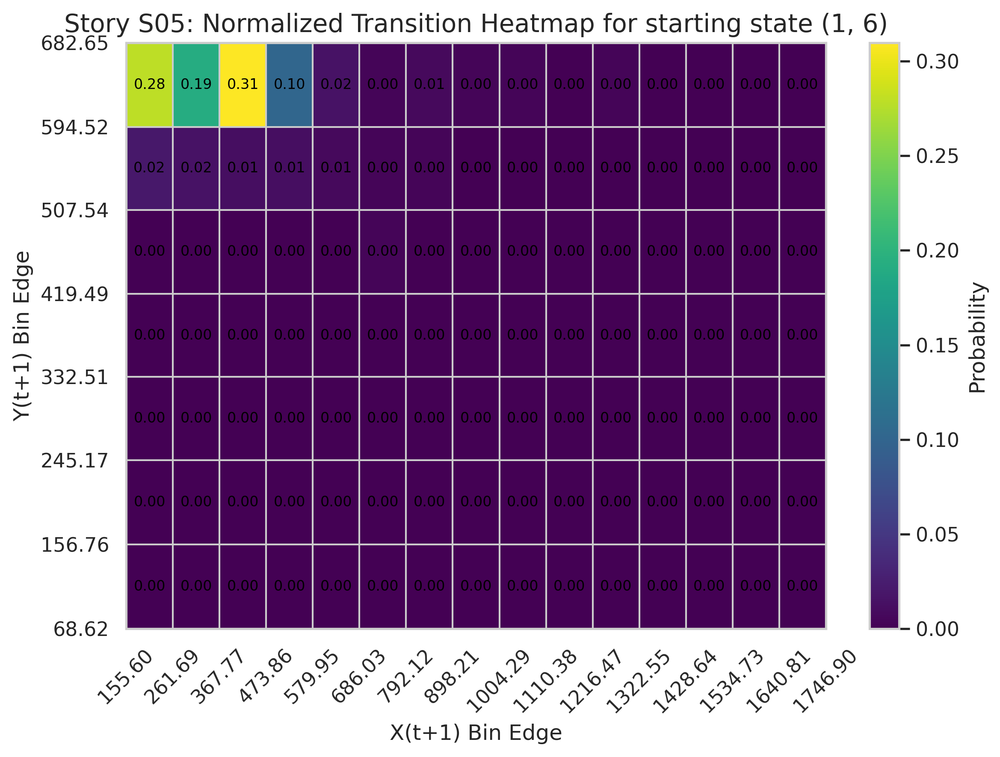


Processing story: S33
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.026
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S33               ADHD                   197.895683   
1       P1171  P1171-S33               ADHD                   195.187936   
2       P1379  P1379-S33               ADHD                   798.996937   
3       P1433  P1433-S33                 TD                   183.344539   
4       P1475  P1475-S33                 TD                   288.042247   
..        ...        ...                ...                          ...   
90      P9691  P9691-S33                 TD                   110.006670   
91      P9707  P9707-S33                 TD                   133.689025   
92      P9810  P9810-S33               ADHD                   280.828527   
93      P9881  P9881-S33               ADHD                   729.821263   
94      P9909  P9909-S33              

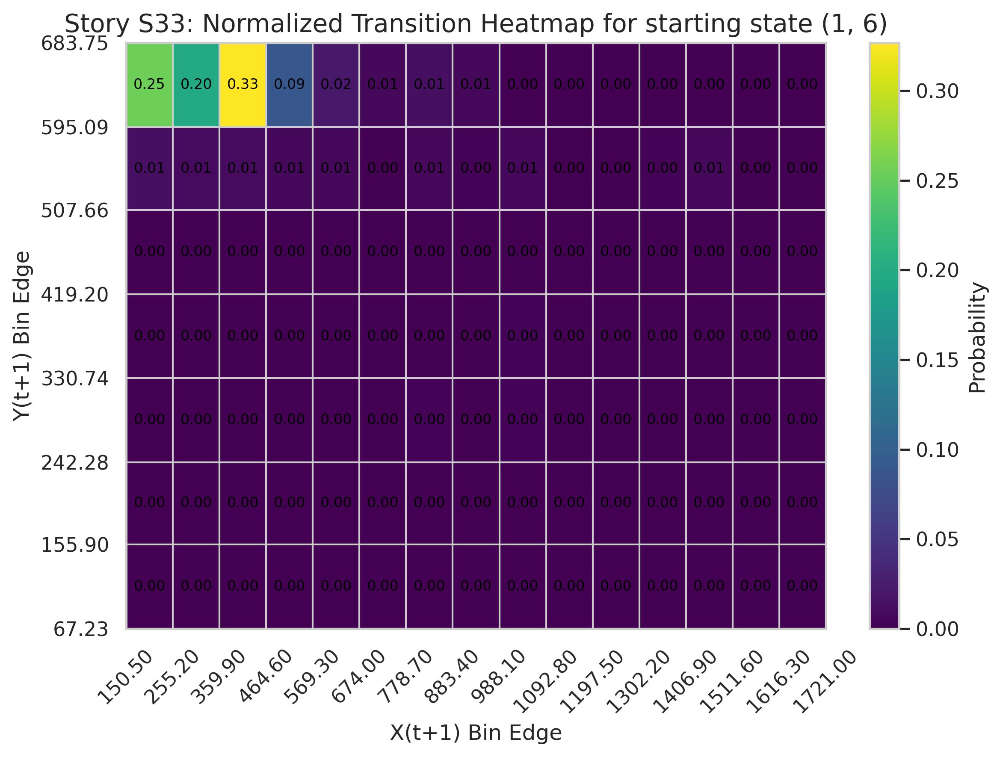


Processing story: S09
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.023
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S09               ADHD                   177.322190   
1       P1171  P1171-S09               ADHD                   143.293380   
2       P1212  P1212-S09                 TD                   676.359692   
3       P1379  P1379-S09               ADHD                   124.877465   
4       P1433  P1433-S09                 TD                    88.092499   
..        ...        ...                ...                          ...   
92      P9691  P9691-S09                 TD                   184.636117   
93      P9707  P9707-S09                 TD                   158.273851   
94      P9810  P9810-S09               ADHD                   130.182747   
95      P9881  P9881-S09               ADHD                   727.601593   
96      P9909  P9909-S09              

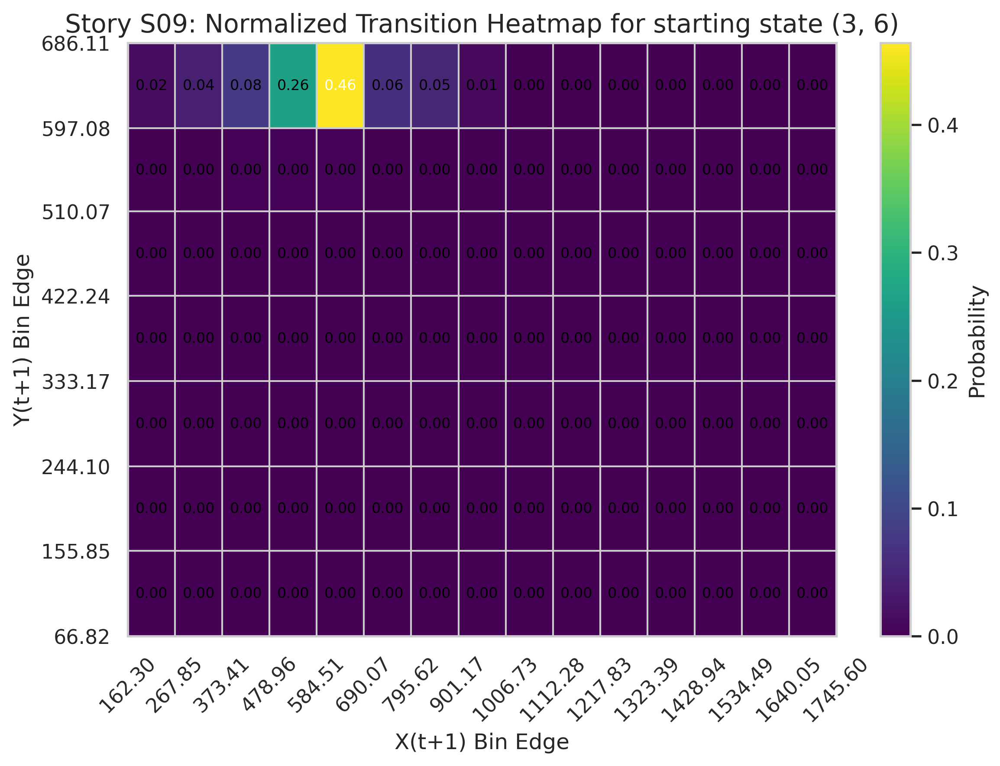


Processing story: S29
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.039
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S29               ADHD                   264.340347   
1       P1171  P1171-S29               ADHD                    67.356236   
2       P1212  P1212-S29                 TD                   633.192687   
3       P1379  P1379-S29               ADHD                   514.160936   
4       P1433  P1433-S29                 TD                    77.554487   
..        ...        ...                ...                          ...   
88      P9691  P9691-S29                 TD                   427.327097   
89      P9707  P9707-S29                 TD                   253.889359   
90      P9810  P9810-S29               ADHD                    98.521622   
91      P9881  P9881-S29               ADHD                   747.336453   
92      P9909  P9909-S29              

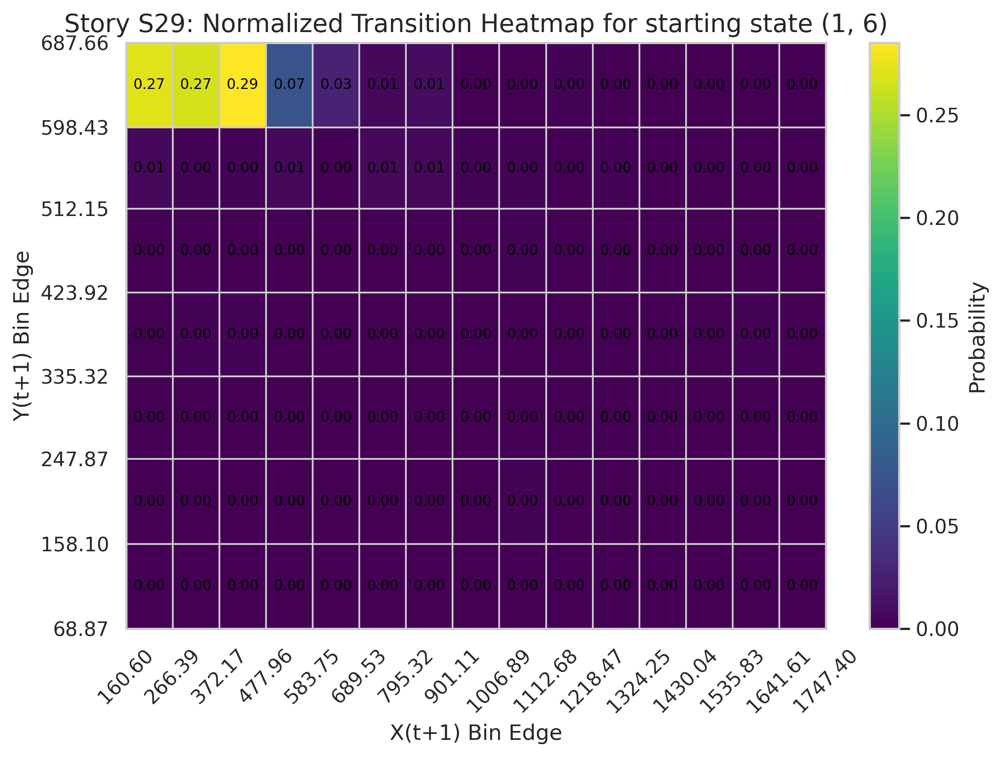


Processing story: S03
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.052
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S03               ADHD                   159.502486   
1       P1171  P1171-S03               ADHD                   103.104386   
2       P1212  P1212-S03                 TD                   372.324311   
3       P1379  P1379-S03               ADHD                   200.311909   
4       P1433  P1433-S03                 TD                   202.152742   
..        ...        ...                ...                          ...   
86      P9687  P9687-S03               ADHD                   127.179719   
87      P9691  P9691-S03                 TD                   205.805758   
88      P9707  P9707-S03                 TD                   138.675198   
89      P9810  P9810-S03               ADHD                   157.667943   
90      P9909  P9909-S03              

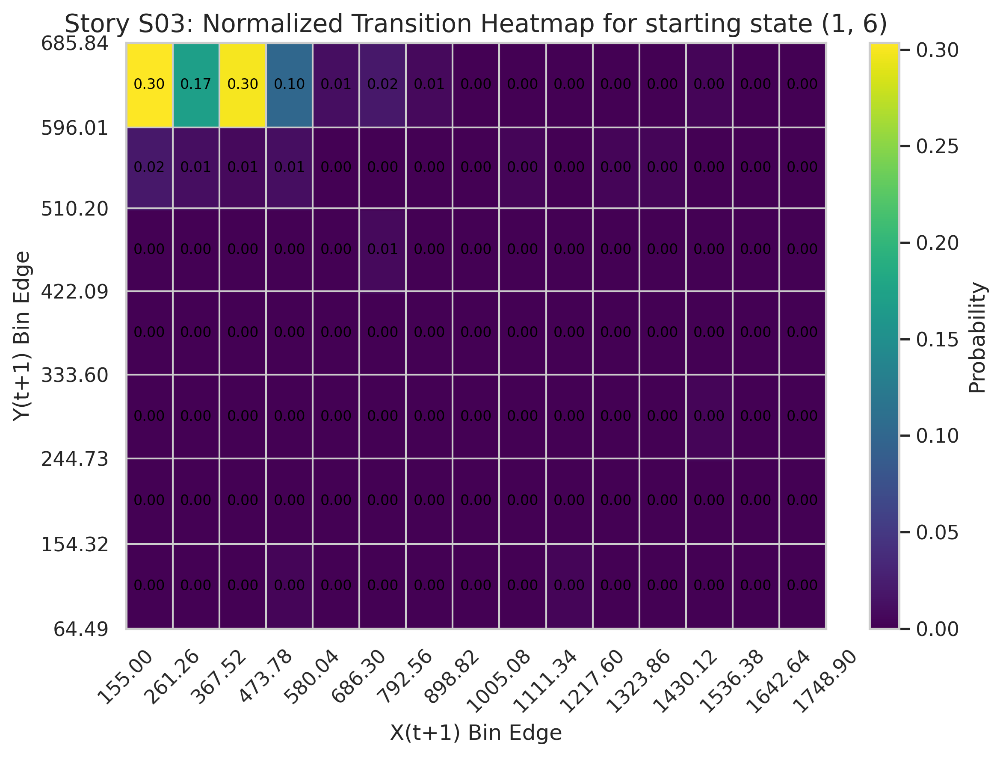


Processing story: S23
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.038
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S23               ADHD                   175.185102   
1       P1171  P1171-S23               ADHD                    96.849133   
2       P1212  P1212-S23                 TD                   610.171607   
3       P1379  P1379-S23               ADHD                   295.068280   
4       P1433  P1433-S23                 TD                   236.955293   
..        ...        ...                ...                          ...   
95      P9691  P9691-S23                 TD                   290.581361   
96      P9707  P9707-S23                 TD                   217.755345   
97      P9810  P9810-S23               ADHD                   127.077826   
98      P9881  P9881-S23               ADHD                   184.088846   
99      P9909  P9909-S23              

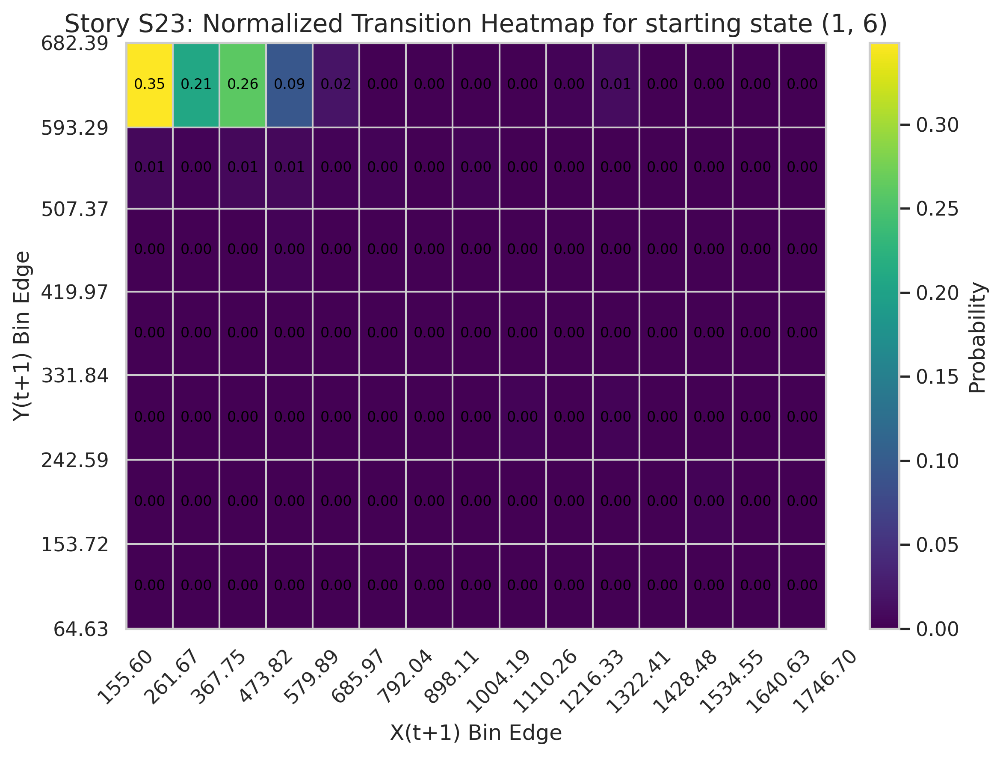


Processing story: S07
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.041
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S07               ADHD                   181.456695   
1       P1171  P1171-S07               ADHD                   193.790822   
2       P1212  P1212-S07                 TD                   378.330225   
3       P1379  P1379-S07               ADHD                   194.134031   
4       P1433  P1433-S07                 TD                   238.858282   
..        ...        ...                ...                          ...   
88      P9687  P9687-S07               ADHD                   128.846077   
89      P9691  P9691-S07                 TD                   365.780434   
90      P9707  P9707-S07                 TD                   207.238763   
91      P9810  P9810-S07               ADHD                   123.387301   
92      P9909  P9909-S07              

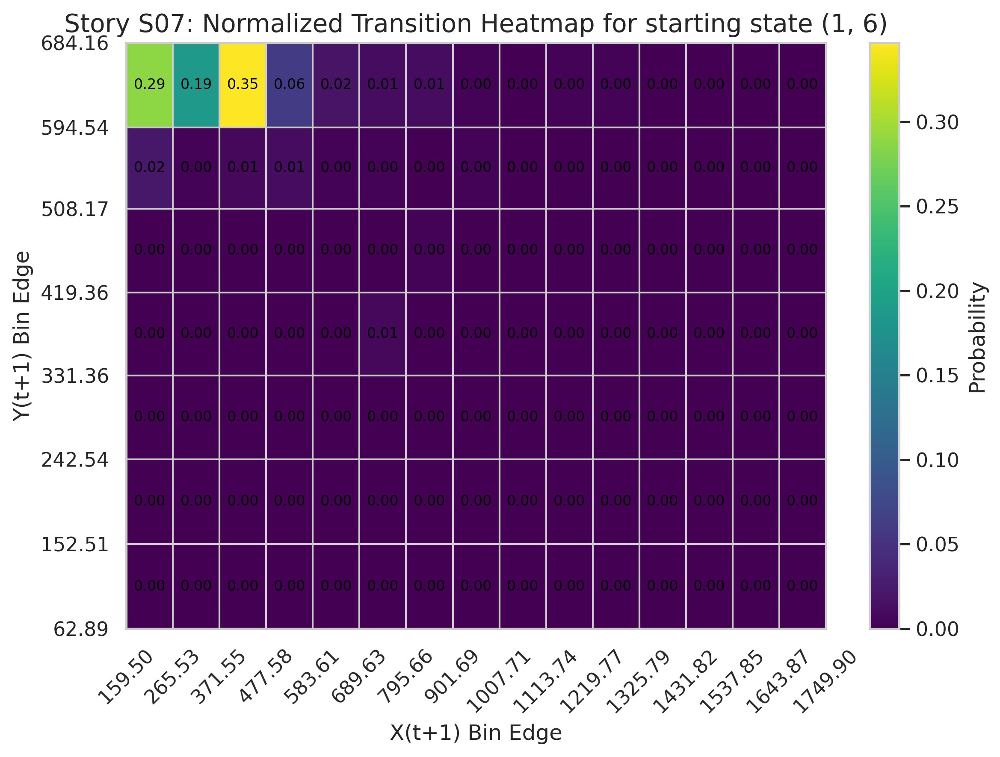


Processing story: S11
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.019
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S11               ADHD                   206.802546   
1       P1171  P1171-S11               ADHD                   281.013081   
2       P1379  P1379-S11               ADHD                   116.001577   
3       P1433  P1433-S11                 TD                   117.874564   
4       P1475  P1475-S11                 TD                   290.236576   
..        ...        ...                ...                          ...   
92      P9691  P9691-S11                 TD                   543.319622   
93      P9707  P9707-S11                 TD                   207.098153   
94      P9810  P9810-S11               ADHD                   141.222949   
95      P9881  P9881-S11               ADHD                   330.276056   
96      P9909  P9909-S11              

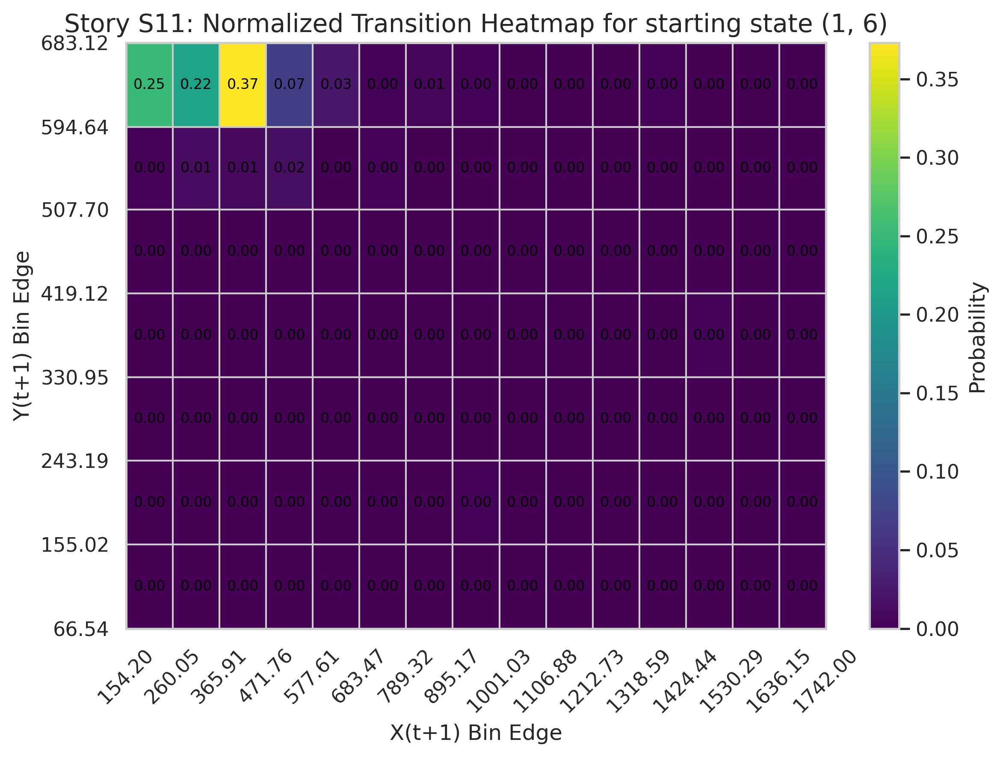


Processing story: S16
Binning method: KDE, Number of Y-Bins: 8, Δy Ratio: 0.052
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S16               ADHD                   102.245152   
1       P1171  P1171-S16               ADHD                   225.979068   
2       P1212  P1212-S16                 TD                   363.398934   
3       P1379  P1379-S16               ADHD                   952.073478   
4       P1433  P1433-S16                 TD                   105.014254   
..        ...        ...                ...                          ...   
89      P9687  P9687-S16               ADHD                   152.963070   
90      P9691  P9691-S16                 TD                   160.520848   
91      P9707  P9707-S16                 TD                   143.036567   
92      P9881  P9881-S16               ADHD                   182.990742   
93      P9909  P9909-S16              

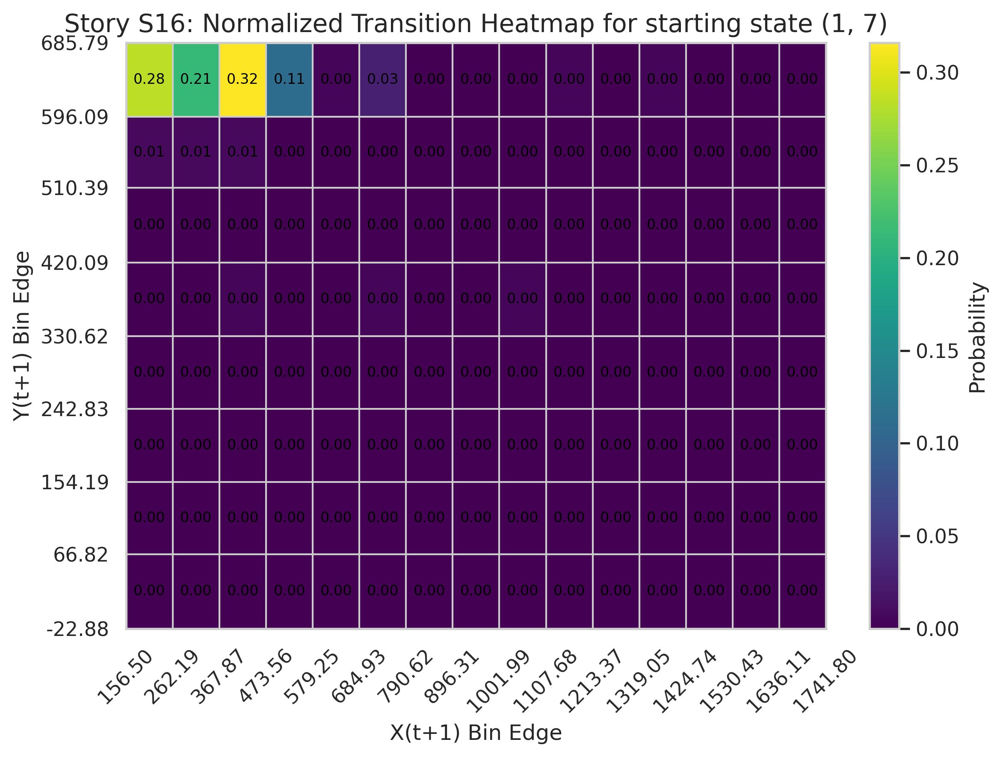


Processing story: S22
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.040
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S22               ADHD                   118.376054   
1       P1171  P1171-S22               ADHD                   265.627905   
2       P1212  P1212-S22                 TD                   398.817411   
3       P1379  P1379-S22               ADHD                   891.063504   
4       P1433  P1433-S22                 TD                   154.813339   
..        ...        ...                ...                          ...   
89      P9569  P9569-S22                 TD                   338.796281   
90      P9687  P9687-S22               ADHD                   154.161489   
91      P9691  P9691-S22                 TD                   269.343110   
92      P9707  P9707-S22                 TD                   256.289243   
93      P9810  P9810-S22              

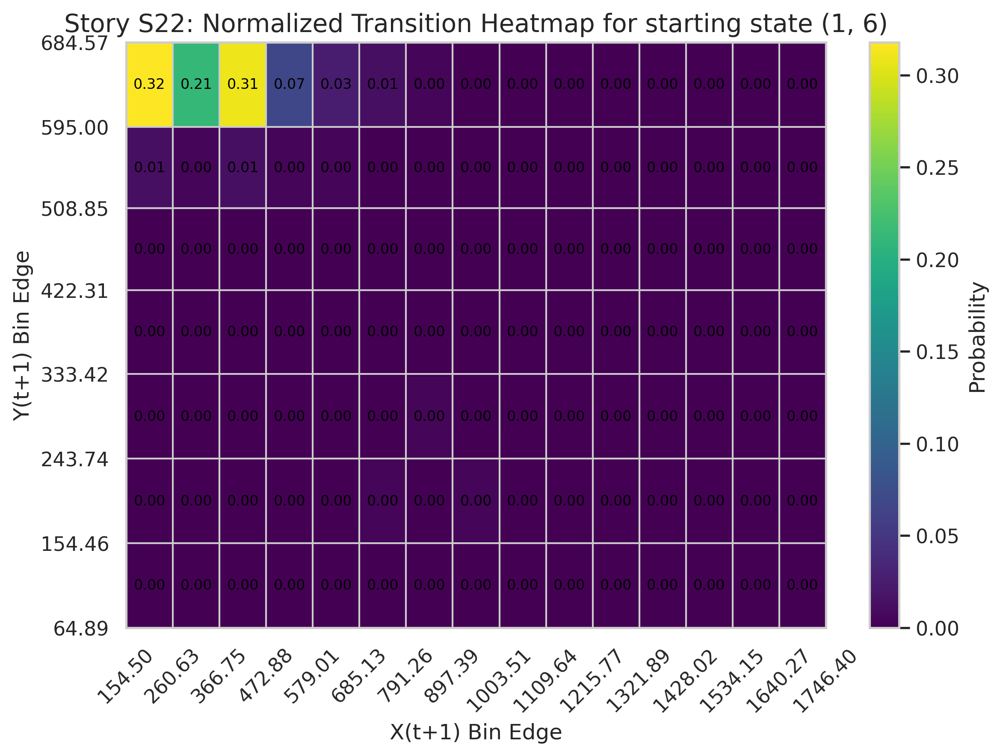


Processing story: S13
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.057
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S13               ADHD                   121.252510   
1       P1171  P1171-S13               ADHD                   115.860219   
2       P1212  P1212-S13                 TD                   618.948490   
3       P1379  P1379-S13               ADHD                   234.731802   
4       P1433  P1433-S13                 TD                   411.902320   
..        ...        ...                ...                          ...   
88      P9687  P9687-S13               ADHD                   445.829521   
89      P9691  P9691-S13                 TD                   668.781176   
90      P9707  P9707-S13                 TD                   184.780455   
91      P9810  P9810-S13               ADHD                   281.563278   
92      P9909  P9909-S13              

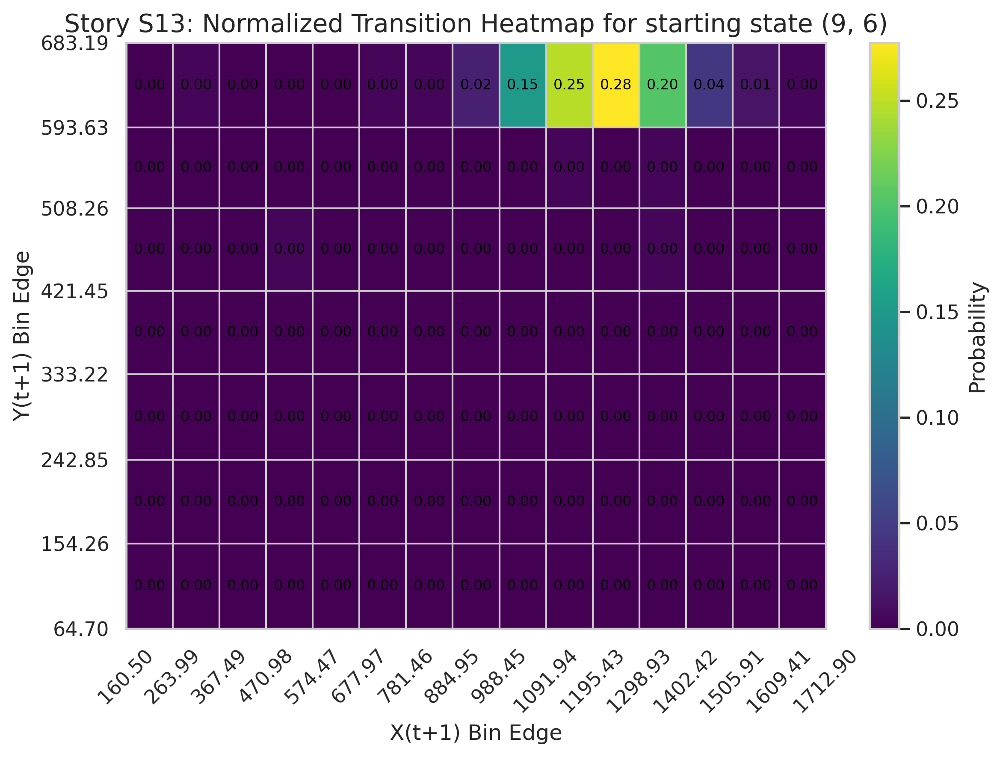


Processing story: S21
Binning method: KDE, Number of Y-Bins: 6, Δy Ratio: 0.022
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S21               ADHD                   357.152741   
1       P1171  P1171-S21               ADHD                   240.604238   
2       P1212  P1212-S21                 TD                   425.004150   
3       P1379  P1379-S21               ADHD                   355.956685   
4       P1433  P1433-S21                 TD                   322.052755   
..        ...        ...                ...                          ...   
90      P9687  P9687-S21               ADHD                   223.141335   
91      P9707  P9707-S21                 TD                   525.476480   
92      P9810  P9810-S21               ADHD                   202.139929   
93      P9881  P9881-S21               ADHD                   836.839369   
94      P9909  P9909-S21              

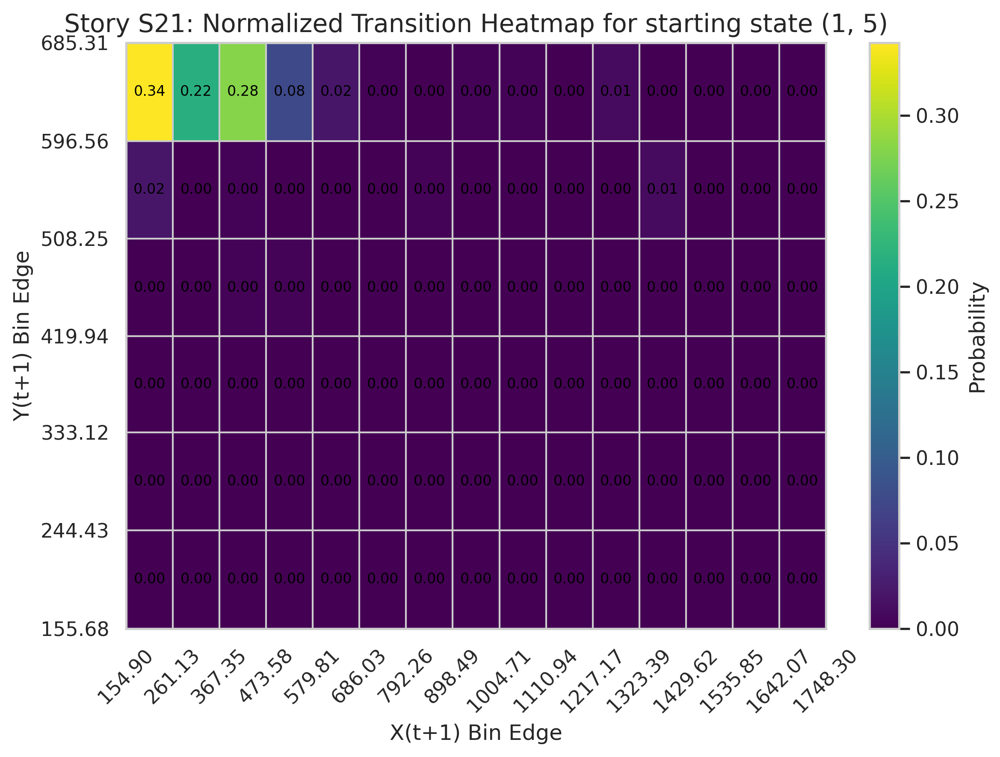


Processing story: S35
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.059
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S35               ADHD                   220.276511   
1       P1212  P1212-S35                 TD                   198.110606   
2       P1379  P1379-S35               ADHD                   198.140226   
3       P1433  P1433-S35                 TD                   157.516926   
4       P1475  P1475-S35                 TD                   222.155485   
..        ...        ...                ...                          ...   
87      P9569  P9569-S35                 TD                   258.577521   
88      P9687  P9687-S35               ADHD                   138.651328   
89      P9691  P9691-S35                 TD                   175.510386   
90      P9810  P9810-S35               ADHD                   250.695408   
91      P9909  P9909-S35              

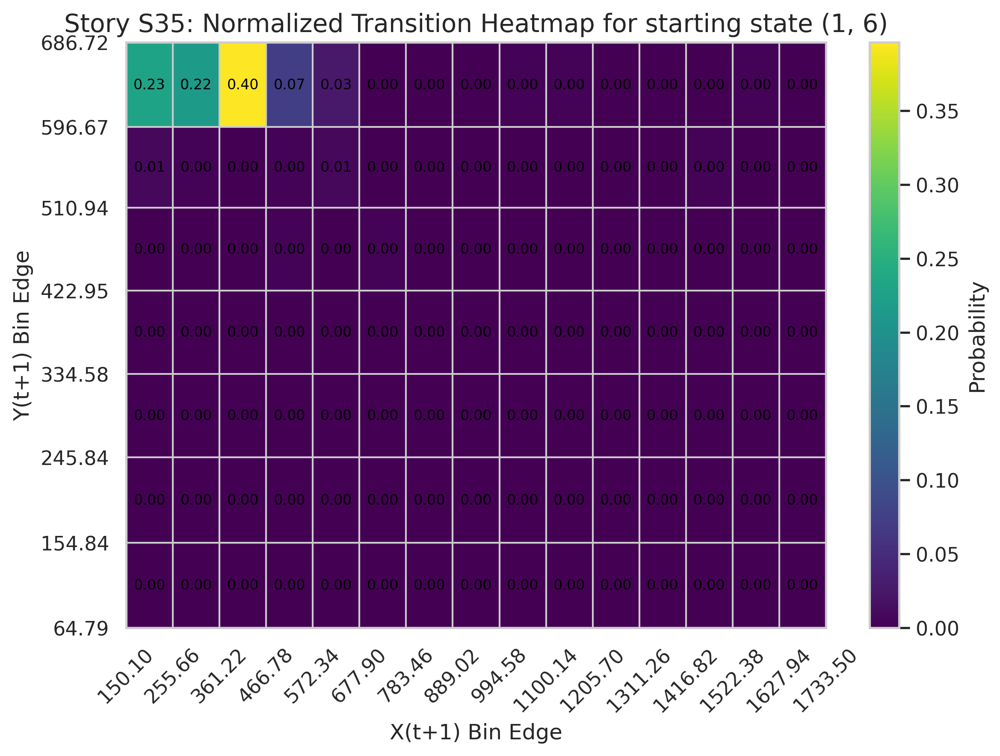


Processing story: S25
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.022
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S25               ADHD                   109.554586   
1       P1171  P1171-S25               ADHD                   132.115013   
2       P1212  P1212-S25                 TD                   691.279579   
3       P1379  P1379-S25               ADHD                   375.774614   
4       P1433  P1433-S25                 TD                   128.645048   
..        ...        ...                ...                          ...   
87      P9691  P9691-S25                 TD                   690.927507   
88      P9707  P9707-S25                 TD                   216.514048   
89      P9810  P9810-S25               ADHD                   646.846294   
90      P9881  P9881-S25               ADHD                   954.108508   
91      P9909  P9909-S25              

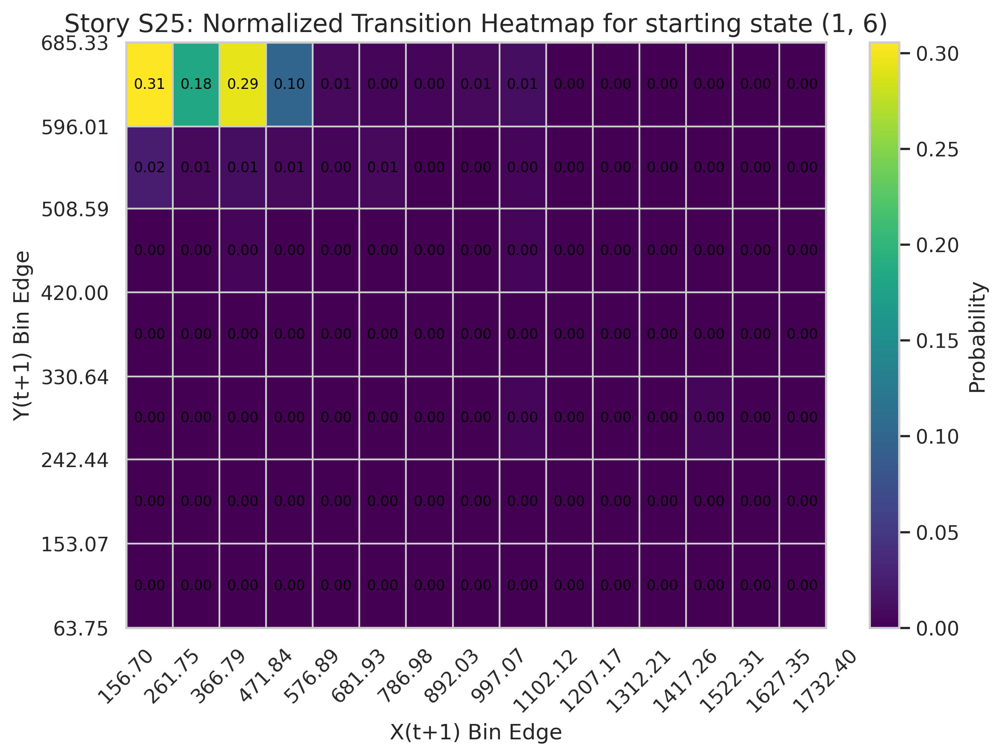


Processing story: S01
Binning method: KDE, Number of Y-Bins: 6, Δy Ratio: 0.020
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S01               ADHD                   200.071898   
1       P1171  P1171-S01               ADHD                   109.306177   
2       P1212  P1212-S01                 TD                   812.074122   
3       P1379  P1379-S01               ADHD                   872.760631   
4       P1433  P1433-S01                 TD                   106.761276   
..        ...        ...                ...                          ...   
84      P9687  P9687-S01               ADHD                   192.901076   
85      P9691  P9691-S01                 TD                    81.850444   
86      P9707  P9707-S01                 TD                   275.082176   
87      P9810  P9810-S01               ADHD                   372.472984   
88      P9909  P9909-S01              

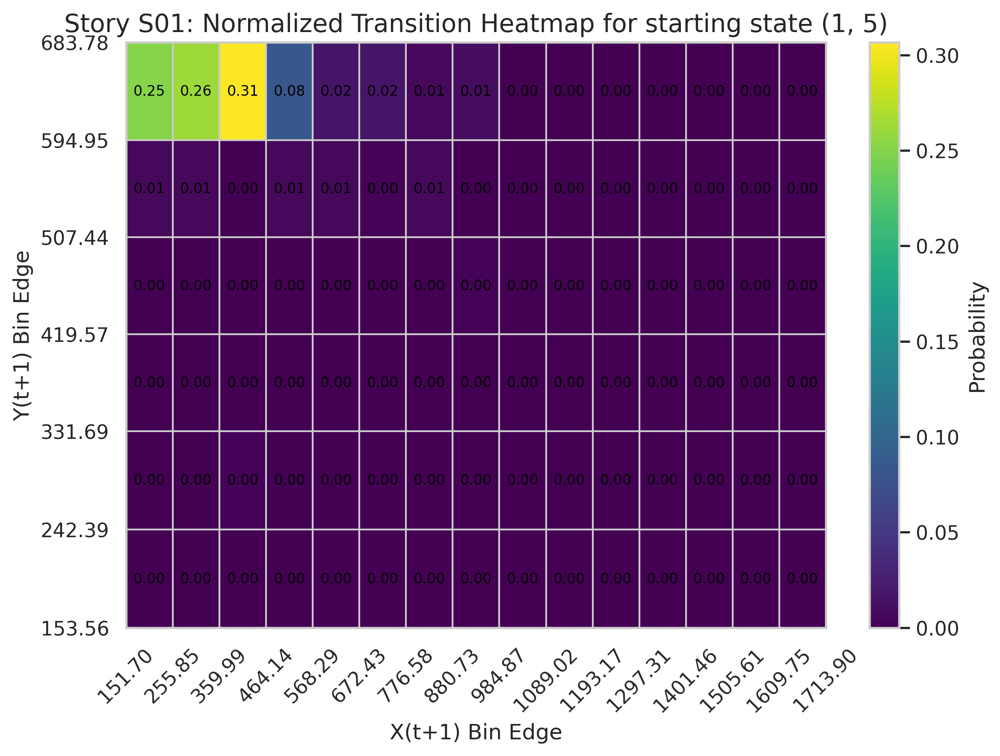


Processing story: S14
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.046
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S14               ADHD                   170.658403   
1       P1171  P1171-S14               ADHD                   256.646014   
2       P1212  P1212-S14                 TD                   446.036584   
3       P1379  P1379-S14               ADHD                   905.819914   
4       P1433  P1433-S14                 TD                    80.840840   
..        ...        ...                ...                          ...   
93      P9691  P9691-S14                 TD                   254.934768   
94      P9707  P9707-S14                 TD                   104.138794   
95      P9810  P9810-S14               ADHD                    92.806324   
96      P9881  P9881-S14               ADHD                   213.403233   
97      P9909  P9909-S14              

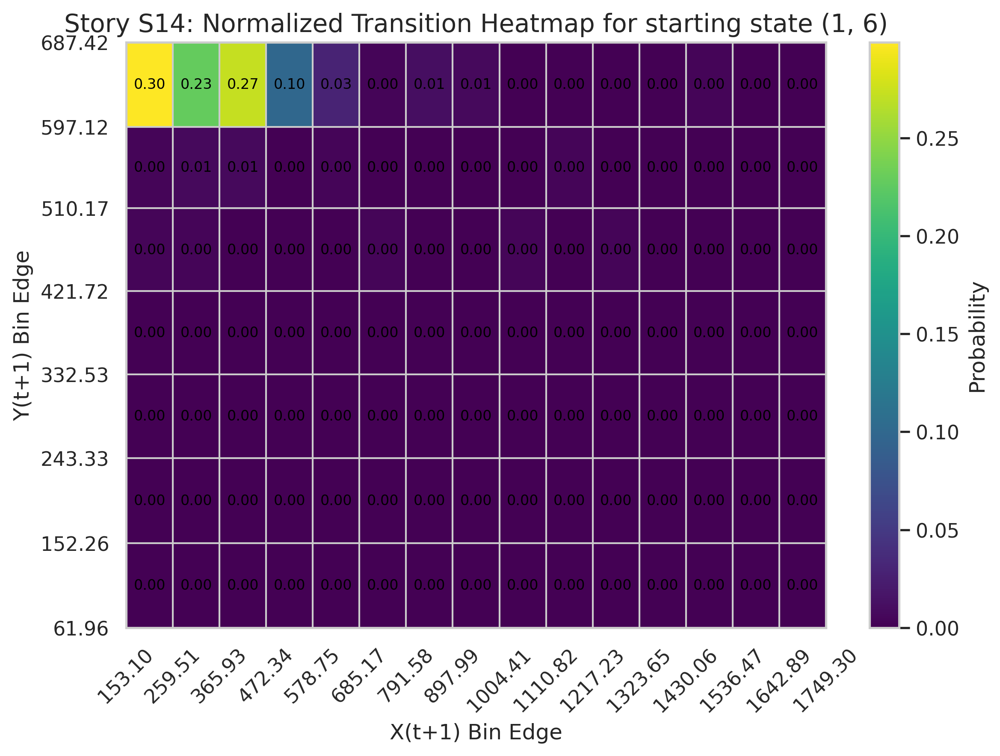


Processing story: S20
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.042
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S20               ADHD                   126.212936   
1       P1171  P1171-S20               ADHD                   210.292199   
2       P1212  P1212-S20                 TD                   559.126494   
3       P1379  P1379-S20               ADHD                   139.302733   
4       P1433  P1433-S20                 TD                    68.156190   
..        ...        ...                ...                          ...   
93      P9687  P9687-S20               ADHD                   167.187105   
94      P9691  P9691-S20                 TD                   124.281179   
95      P9707  P9707-S20                 TD                   257.631313   
96      P9810  P9810-S20               ADHD                   159.983402   
97      P9909  P9909-S20              

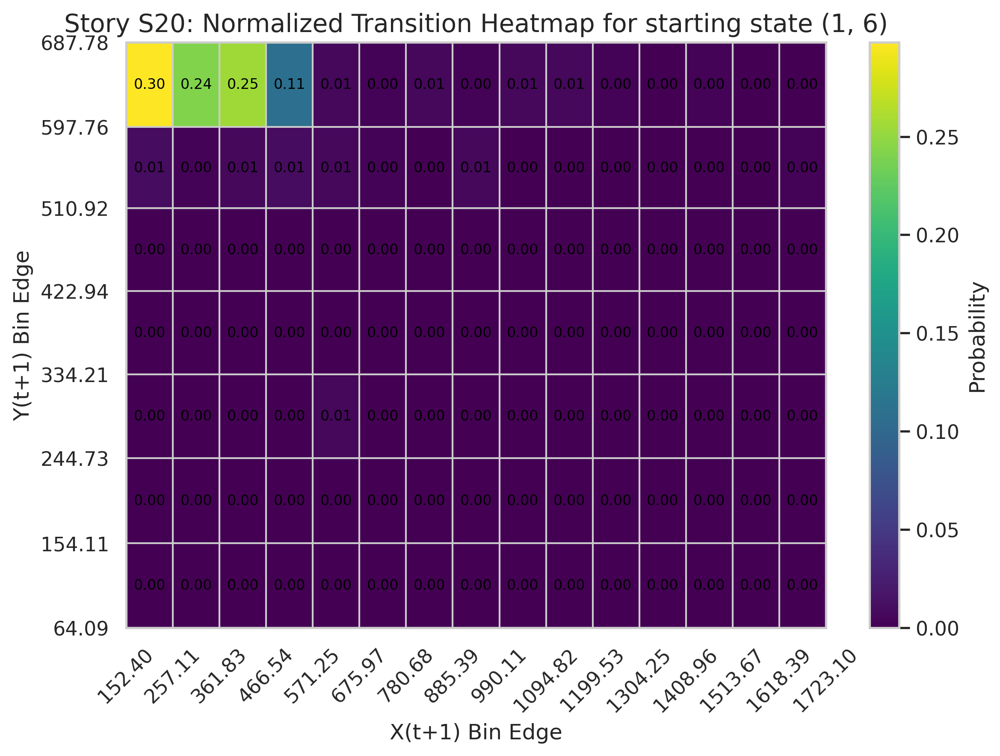


Processing story: S19
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.036
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1142  P1142-S19               ADHD                   177.301026   
1       P1171  P1171-S19               ADHD                   164.687693   
2       P1212  P1212-S19                 TD                   321.438337   
3       P1379  P1379-S19               ADHD                   177.179316   
4       P1433  P1433-S19                 TD                    98.411703   
..        ...        ...                ...                          ...   
92      P9687  P9687-S19               ADHD                   102.487078   
93      P9691  P9691-S19                 TD                   329.985371   
94      P9707  P9707-S19                 TD                   169.310898   
95      P9810  P9810-S19               ADHD                   416.761886   
96      P9909  P9909-S19              

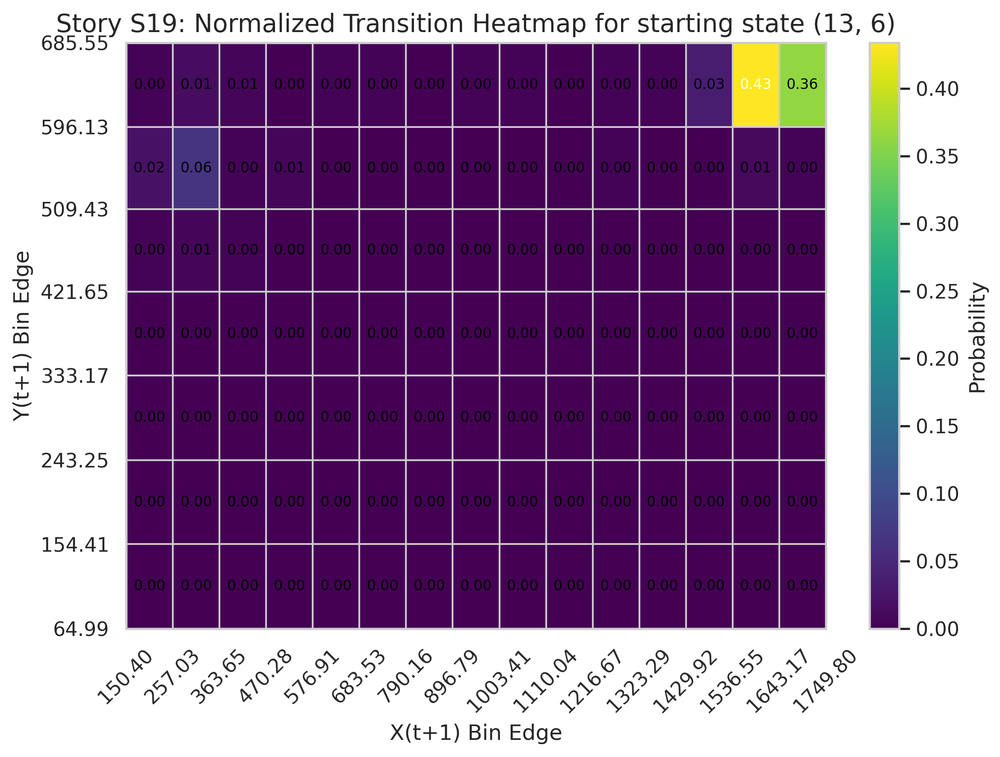


Processing story: S34
Binning method: KDE, Number of Y-Bins: 7, Δy Ratio: 0.032
Fixation Deviation Statistics (per subject):
   Subject_ID   Story_ID Experimental_Group  Fixation_Deviation_Variance  \
0       P1171  P1171-S34               ADHD                   179.903693   
1       P1212  P1212-S34                 TD                   496.642919   
2       P1379  P1379-S34               ADHD                   407.566368   
3       P1433  P1433-S34                 TD                   305.892362   
4       P1475  P1475-S34                 TD                   250.531058   
..        ...        ...                ...                          ...   
89      P9687  P9687-S34               ADHD                   313.912227   
90      P9691  P9691-S34                 TD                   260.689200   
91      P9707  P9707-S34                 TD                   228.124723   
92      P9810  P9810-S34               ADHD                   138.671908   
93      P9909  P9909-S34              

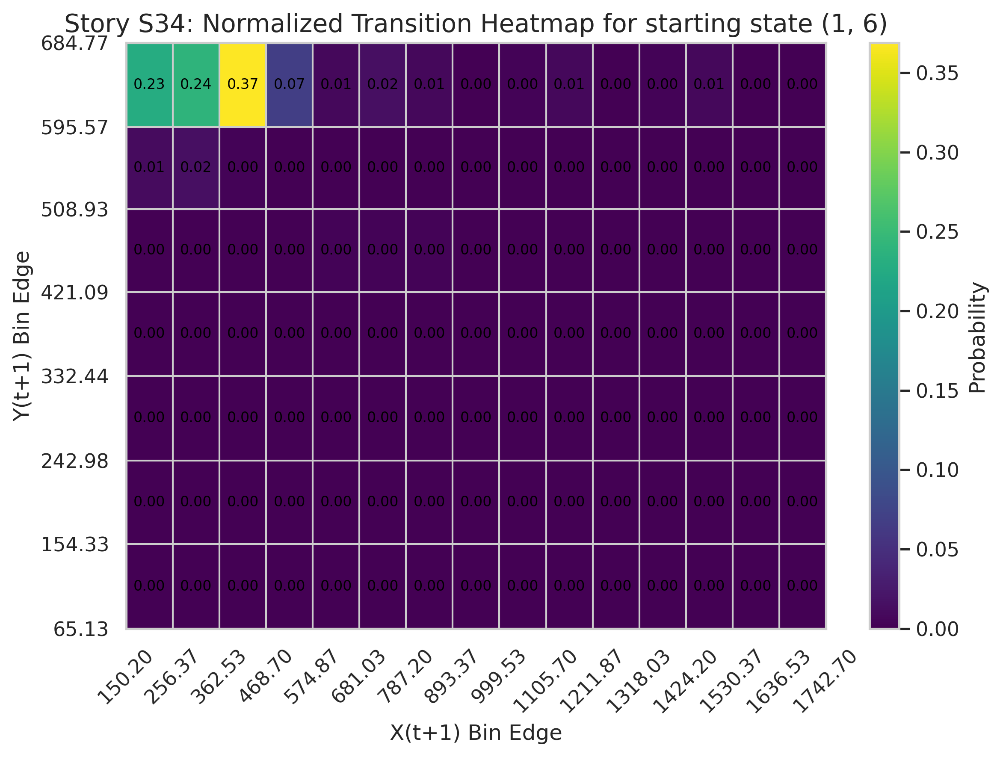


Saved integrated summary for all stories to /content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/integrated_summary_all_stories10_01.csv


In [ ]:
# -----------------------------------------------------------
# 1. Library Imports and Google Drive Mounting
# -----------------------------------------------------------
from google.colab import drive
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import find_peaks, savgol_filter
from scipy.stats import iqr, skew, kurtosis, entropy
from sklearn.neighbors import KernelDensity
from scipy.optimize import minimize_scalar
import math

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)
file_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/all_trials_merged.csv"

# -----------------------------------------------------------
# 2. Outlier Detection
# -----------------------------------------------------------
def detect_outliers_iqr(y_values, threshold=1.5):
    q1 = np.percentile(y_values, 25)
    q3 = np.percentile(y_values, 75)
    iqr_value = q3 - q1
    lower_bound = q1 - threshold * iqr_value
    upper_bound = q3 + threshold * iqr_value
    outliers = (y_values < lower_bound) | (y_values > upper_bound)
    return outliers

# -----------------------------------------------------------
# 2b. Helper to Clip Values for Binning
# -----------------------------------------------------------
def clip_values(values, bin_edges):
    """
    Clips numeric array 'values' to the min/max of 'bin_edges'.
    Ensures values don't fall outside the computed bin range.
    """
    return np.clip(values, bin_edges[0], bin_edges[-1])

# -----------------------------------------------------------
# 3. Core Binning Logic (Hybrid KDE Binning)
# -----------------------------------------------------------
def hybrid_kde_binning(y_values, min_required_bins=2, max_cv=0.10):
    outliers = detect_outliers_iqr(y_values)
    y_filtered = y_values[~outliers]

    bandwidth = 0.5 * min(np.std(y_filtered), iqr(y_filtered) / 1.34) * len(y_filtered) ** (-1 / 5)
    kde = KernelDensity(bandwidth=bandwidth).fit(y_filtered.reshape(-1, 1))

    y_grid = np.linspace(y_filtered.min(), y_filtered.max(), 1000)
    log_density = kde.score_samples(y_grid.reshape(-1, 1))
    density = np.exp(log_density)

    peaks, _ = find_peaks(density, prominence=0.01 * np.max(density))

    if len(peaks) < min_required_bins:
        bin_centers = np.percentile(y_filtered, np.linspace(0, 100, min_required_bins + 2)[1:-1])
        method = "Percentile"
    else:
        bin_centers = y_grid[peaks]
        method = "KDE"

    if len(bin_centers) > 1:
        interior_edges = (bin_centers[:-1] + bin_centers[1:]) / 2
        spacings = np.diff(interior_edges)
        robust_spacing = np.mean(spacings) + 1 * np.std(spacings)

        lower_edge = interior_edges[0] - robust_spacing
        upper_edge = interior_edges[-1] + robust_spacing
        bin_edges = np.concatenate([[lower_edge], interior_edges, [upper_edge]])
    else:
        delta = np.std(y_filtered) if np.std(y_filtered) > 0 else 1.0
        bin_edges = np.array([bin_centers[0] - delta, bin_centers[0] + delta])

    delta_y = np.diff(bin_edges)
    mean_delta = np.mean(delta_y)
    ratio = (np.max(delta_y) - np.min(delta_y)) / mean_delta if mean_delta != 0 else np.nan

    return bin_edges, bin_centers, outliers, method, len(bin_edges) - 1, ratio, y_grid, density, peaks

# -----------------------------------------------------------
# 4. Compute Fixed X-Bins
# -----------------------------------------------------------
def compute_x_bins(x_values, num_bins=15):
    x_min = np.min(x_values)
    x_max = np.max(x_values)
    return np.linspace(x_min, x_max, num_bins + 1)

# -----------------------------------------------------------
# 5. Data Loading
# -----------------------------------------------------------
def load_story_data(file_path, story_filter=None):
    df = pd.read_csv(file_path)
    if story_filter:
        df = df[df['Story'].str.contains(story_filter)]
    return df

# -----------------------------------------------------------
# 6. Feature Extraction: Fixation Deviation Statistics (use RAW y)
# -----------------------------------------------------------
def extract_statistics(df, bin_centers):
    def assign_nearest_center(y_values, centers):
        indices = np.abs(y_values[:, None] - centers).argmin(axis=1)
        return centers[indices]

    stats_dict = {}
    for subject in df['Participant_ID'].unique():
        df_sub = df[df['Participant_ID'] == subject].copy()

        # Use raw y-values (no clipping)
        y_values = df_sub['y'].values
        nearest_centers = assign_nearest_center(y_values, bin_centers)
        diff = y_values - nearest_centers

        stats_dict[subject] = {
            'Story_ID': df_sub['Story'].iloc[0] if 'Story' in df_sub.columns else None,
            'Experimental_Group': df_sub['Group'].iloc[0] if 'Group' in df_sub.columns else None,
            'Fixation_Deviation_Variance': np.var(diff, ddof=1),
            'Fixation_Deviation_Median': np.median(diff),
            'Fixation_Deviation_Skewness': skew(diff),
            'Fixation_Deviation_Kurtosis': kurtosis(diff, fisher=True)
        }

    summary_df = pd.DataFrame.from_dict(stats_dict, orient='index')
    summary_df.index.name = 'Subject_ID'
    summary_df.reset_index(inplace=True)
    return summary_df

# -----------------------------------------------------------
# 7. Abnormal Reading Feature Extraction (TRANSITIONS USE CLIPPED X/Y)
# -----------------------------------------------------------
def extract_abnormal_reading_feature(df):
    x_bins = compute_x_bins(df['x'].values, num_bins=15)
    bin_edges, bin_centers, outliers, method, num_y_bins, ratio, y_grid, density, peaks = hybrid_kde_binning(df['y'].values)

    Nx = len(x_bins) - 1
    Ny = num_y_bins

    df = df.copy()
    # Clip x and y to bin edges
    df['x_clipped'] = clip_values(df['x'].values, x_bins)
    df['y_clipped'] = clip_values(df['y'].values, bin_edges)

    # Digitize
    df['x_bin'] = np.digitize(df['x_clipped'], x_bins) - 1
    df['y_bin'] = np.digitize(df['y_clipped'], bin_edges) - 1

    # Clip bin indices
    df['x_bin'] = np.clip(df['x_bin'], 0, Nx - 1)
    df['y_bin'] = np.clip(df['y_bin'], 0, Ny - 1)

    transitions_matrix = np.zeros((Nx, Ny, Nx, Ny))
    subject_transitions = {}
    subject_states = {}

    for subject, group in df.groupby('Participant_ID'):
        group = group.sort_index()
        states = list(zip(group['x_bin'], group['y_bin']))
        subject_states[subject] = states

        transitions = []
        for i in range(len(states) - 1):
            start_state = states[i]
            next_state = states[i + 1]
            transitions.append((start_state, next_state))
            sx, sy = start_state
            ex, ey = next_state
            transitions_matrix[sx, sy, ex, ey] += 1
        subject_transitions[subject] = transitions

    P_av_matrix = np.zeros_like(transitions_matrix)
    start_state_counts = np.zeros((Nx, Ny))
    for i in range(Nx):
        for j in range(Ny):
            total = np.sum(transitions_matrix[i, j, :, :])
            start_state_counts[i, j] = total
            if total > 0:
                P_av_matrix[i, j, :, :] = transitions_matrix[i, j, :, :] / total

    flat_global = P_av_matrix.flatten()
    story_probs = flat_global[flat_global > 0]
    story_entropy = entropy(story_probs, base=2)

    subject_log_likelihood = {}
    for subject, transitions in subject_transitions.items():
        log_prob = 0.0
        for (start_state, next_state) in transitions:
            sx, sy = start_state
            ex, ey = next_state
            prob = P_av_matrix[sx, sy, ex, ey]
            log_prob += math.log(prob) if prob > 0 else -999
        subject_log_likelihood[subject] = log_prob

    features = []
    for subject, log_prob in subject_log_likelihood.items():
        group_df = df[df['Participant_ID'] == subject]
        n = len(subject_transitions[subject])
        cross_entropy = -log_prob / n if n > 0 else np.nan
        entropy_deviation = cross_entropy - story_entropy

        features.append({
            'Subject_ID': subject,
            'Story_ID': group_df['Story'].iloc[0] if 'Story' in group_df.columns else None,
            'Experimental_Group': group_df['Group'].iloc[0] if 'Group' in group_df.columns else None,
            'Log_Prob_Sum': log_prob,
            'Entropy_Deviation': entropy_deviation
        })

    summary_table = pd.DataFrame(features)
    return summary_table, P_av_matrix, subject_transitions, subject_states, x_bins, bin_edges, bin_centers, start_state_counts

# -----------------------------------------------------------
# 8. Extract Additional Markov Features
# -----------------------------------------------------------
def extract_markov_additional_features(subject_transitions, subject_states, P_av_matrix, x_bins, bin_edges, y_centers=None):
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    if y_centers is None:
        y_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    features = {}
    for subject in subject_transitions.keys():
        transitions = subject_transitions[subject]
        states = subject_states[subject]
        total = len(transitions)
        if total == 0 or len(states) < 3:
            continue

        self_transitions = 0
        regression_transitions = 0
        amplitudes = []
        median_saccade_amplitudes = []
        regression_amplitudes = []
        y_reg_amplitudes = []
        regression_log_prob = 0.0
        self_prob_sum = 0.0
        nonself_prob_sum = 0.0
        regression_prob_sum = 0.0
        weighted_amp_sum = 0.0

        for (start_state, next_state) in transitions:
            sx, sy = start_state
            ex, ey = next_state
            start_coord = np.array([x_centers[sx], y_centers[sy]])
            next_coord = np.array([x_centers[ex], y_centers[ey]])
            amp = np.linalg.norm(next_coord - start_coord)
            prob = P_av_matrix[sx, sy, ex, ey]

            if start_state == next_state:
                self_transitions += 1
                self_prob_sum += prob
            else:
                amplitudes.append(amp)
                median_saccade_amplitudes.append(amp)
                nonself_prob_sum += prob
                weighted_amp_sum += prob * amp

                # 'Regression' in x
                if next_coord[0] < start_coord[0]:
                    regression_transitions += 1
                    regression_amplitudes.append(amp)
                    regression_prob_sum += prob
                    regression_log_prob += math.log(prob) if prob > 0 else -999

                # 'Regression' in y
                if next_coord[1] < start_coord[1]:
                    y_reg_amplitudes.append(abs(next_coord[1] - start_coord[1]))

        count_self_ratio = self_transitions / total if total > 0 else np.nan
        count_reg_ratio = regression_transitions / total if total > 0 else np.nan
        mean_amp = np.mean(amplitudes) if amplitudes else np.nan
        median_sac_amp = np.median(median_saccade_amplitudes) if median_saccade_amplitudes else np.nan
        median_reg_amp = np.median(regression_amplitudes) if regression_amplitudes else np.nan
        median_y_reg_amp = np.median(y_reg_amplitudes) if y_reg_amplitudes else np.nan

        self_prob_ratio = self_prob_sum / nonself_prob_sum if nonself_prob_sum > 0 else np.nan
        regression_prob_ratio = regression_prob_sum / nonself_prob_sum if nonself_prob_sum > 0 else np.nan
        weighted_mean_amp_prob = weighted_amp_sum / nonself_prob_sum if nonself_prob_sum > 0 else np.nan

        fix_to_sac = 0
        sac_to_fix = 0
        fix_to_sac_prob_sum = 0.0
        sac_to_fix_prob_sum = 0.0

        # Additional F->S and S->F analysis
        for i in range(1, len(states)-1):
            if states[i-1] == states[i] and states[i] != states[i+1]:
                fix_to_sac += 1
                sx, sy = states[i]
                ex, ey = states[i+1]
                fix_to_sac_prob_sum += P_av_matrix[sx, sy, ex, ey]
            if states[i-1] != states[i] and states[i] == states[i+1]:
                sac_to_fix += 1
                sx, sy = states[i]
                ex, ey = states[i+1]
                sac_to_fix_prob_sum += P_av_matrix[sx, sy, ex, ey]

        fs_ratio = fix_to_sac / sac_to_fix if sac_to_fix > 0 else np.nan
        fs_prob_ratio = fix_to_sac_prob_sum / sac_to_fix_prob_sum if sac_to_fix_prob_sum > 0 else np.nan

        features[subject] = {
            'Self_Transition_Ratio_Count': count_self_ratio,
            'Self_Prob_Ratio': self_prob_ratio,
            'Regression_Transition_Ratio_Count': count_reg_ratio,
            'Regression_Prob_Ratio': regression_prob_ratio,
            'Weighted_Mean_Saccade_Amplitude_Count': mean_amp,
            'Weighted_Mean_Saccade_Amplitude_Prob': weighted_mean_amp_prob,
            'Median_Saccade_Amplitude': median_sac_amp,
            'Median_Regression_Amplitude': median_reg_amp,
            'Regression_Log_Prob_Sum': regression_log_prob,
            'Fixation_to_Saccade_Saccade_to_Fixation_Ratio_Count': fs_ratio,
            'FS_Prob_Ratio': fs_prob_ratio,
            'Median_Y_Regression_Amplitude': median_y_reg_amp
        }

    return pd.DataFrame.from_dict(features, orient='index').reset_index().rename(columns={'index':'Subject_ID'})

# -----------------------------------------------------------
# 9. Extreme Features
# -----------------------------------------------------------
def extract_extreme_features(subject_states, subject_transitions, P_av_matrix, x_bins, bin_edges):
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    y_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
    extreme_x_bins = {0, len(x_bins) - 2}
    extreme_y_bins = {0, len(bin_edges) - 2}

    results = {}
    for subject, states in subject_states.items():
        total_fix = len(states)
        if total_fix == 0:
            continue

        count_extreme_x = sum(1 for (xi, yi) in states if xi in extreme_x_bins)
        count_extreme_y = sum(1 for (xi, yi) in states if yi in extreme_y_bins)
        frac_extreme_x = count_extreme_x / total_fix
        frac_extreme_y = count_extreme_y / total_fix

        transitions = subject_transitions.get(subject, [])
        total_prob = 0.0
        extreme_prob = 0.0

        for (start_state, next_state) in transitions:
            sx, sy = start_state
            prob = P_av_matrix[sx, sy, next_state[0], next_state[1]]
            total_prob += prob
            if sx in extreme_x_bins or sy in extreme_y_bins:
                extreme_prob += prob

        prob_extreme_ratio = extreme_prob / total_prob if total_prob > 0 else np.nan

        results[subject] = {
            'Frac_Extreme_X': frac_extreme_x,
            'Frac_Extreme_Y': frac_extreme_y,
            'Prob_Extreme_Ratio': prob_extreme_ratio
        }

    return pd.DataFrame.from_dict(results, orient='index').reset_index().rename(columns={'index': 'Subject_ID'})

# -----------------------------------------------------------
# 10. New Spatial Markov Features
# -----------------------------------------------------------
def extract_state_occupancy_entropy(subject_states):
    entropy_dict = {}
    for subject, states in subject_states.items():
        if not states:
            entropy_dict[subject] = np.nan
            continue
        state_counts = {}
        total = len(states)
        for state in states:
            state_counts[state] = state_counts.get(state, 0) + 1
        probs = [count / total for count in state_counts.values()]
        entropy_dict[subject] = entropy(probs, base=2)
    return pd.DataFrame.from_dict(entropy_dict, orient='index', columns=['State_Occupancy_Entropy']).reset_index().rename(columns={'index': 'Subject_ID'})

def extract_spatial_coverage(subject_states, Nx, Ny):
    coverage = {}
    total_states = Nx * Ny
    for subject, states in subject_states.items():
        unique_states = len(set(states))
        coverage[subject] = unique_states / total_states
    return pd.DataFrame.from_dict(coverage, orient='index', columns=['Spatial_Coverage']).reset_index().rename(columns={'index': 'Subject_ID'})

def extract_mfpt(subject_states):
    mfpt_dict = {}
    for subject, states in subject_states.items():
        if len(states) < 2:
            mfpt_dict[subject] = np.nan
            continue
        first_passage = {}
        last_seen = {}
        for i, state in enumerate(states):
            if state in last_seen:
                first_passage[state] = first_passage.get(state, []) + [i - last_seen[state]]
            last_seen[state] = i
        mfpt = np.mean([np.mean(times) for times in first_passage.values()]) if first_passage else np.nan
        mfpt_dict[subject] = mfpt
    return pd.DataFrame.from_dict(mfpt_dict, orient='index', columns=['Mean_First_Passage_Time']).reset_index().rename(columns={'index': 'Subject_ID'})

def extract_transition_asymmetry(subject_transitions):
    asymmetry = {}
    for subject, transitions in subject_transitions.items():
        if not transitions:
            asymmetry[subject] = np.nan
            continue
        forward = sum(1 for (sx, _), (ex, _) in transitions if ex > sx)
        backward = sum(1 for (sx, _), (ex, _) in transitions if ex < sx)
        asymmetry[subject] = forward / backward if backward > 0 else np.inf if forward > 0 else np.nan
    return pd.DataFrame.from_dict(asymmetry, orient='index', columns=['Transition_Asymmetry']).reset_index().rename(columns={'index': 'Subject_ID'})

# -----------------------------------------------------------
# 11. Plotting Helper: Conditional Heatmap (Optionally saves figure)
# -----------------------------------------------------------
def plot_conditional_histogram_matrix(P_av_matrix, start_state, x_edges, y_edges, title, save_path=None):
    Nx = len(x_edges) - 1
    Ny = len(y_edges) - 1
    i, j = start_state
    prob_matrix = P_av_matrix[i, j, :, :].T
    extent = [x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]]

    plt.figure(figsize=(8, 6))
    im = plt.imshow(prob_matrix, origin='lower', aspect='auto', cmap='viridis', extent=extent)
    plt.colorbar(im, label='Probability')
    plt.xlabel('X(t+1) Bin Edge')
    plt.ylabel('Y(t+1) Bin Edge')
    plt.title(title)

    x_centers = (x_edges[:-1] + x_edges[1:]) / 2
    y_centers = (y_edges[:-1] + y_edges[1:]) / 2

    for yi in range(Ny):
        for xi in range(Nx):
            val = prob_matrix[yi, xi]
            text_color = 'white' if val > 0.4 else 'black'
            plt.text(
                x_centers[xi],
                y_centers[yi],
                f"{val:.2f}",
                ha='center',
                va='center',
                color=text_color,
                fontsize=8
            )

    plt.xticks(ticks=x_edges, labels=[f"{val:.2f}" for val in x_edges], rotation=45)
    plt.yticks(ticks=y_edges, labels=[f"{val:.2f}" for val in y_edges])
    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Heatmap saved to: {save_path}")

    plt.show()

# -----------------------------------------------------------
# 12. Main Execution
# -----------------------------------------------------------
if __name__ == "__main__":
    df = load_story_data(file_path)
    df['Story_Number'] = df['Story'].apply(lambda x: x.split('-')[-1])
    unique_stories = df['Story_Number'].unique()

    all_integrated_summaries = []
    for story in unique_stories:
        if story == "S1":
            # Skip if needed
            continue

        print(f"\nProcessing story: {story}")
        df_story = df[df['Story_Number'] == story].copy()

        # 1) Y-binning, get bin_edges
        bin_edges, bin_centers, outliers, method, num_y_bins, ratio, y_grid, density, peaks = hybrid_kde_binning(df_story['y'].values)
        Nx = len(compute_x_bins(df_story['x'].values)) - 1

        print(f"Binning method: {method}, Number of Y-Bins: {num_y_bins}, Δy Ratio: {ratio:.3f}")

        # 2) Fixation Deviation Stats (raw y)
        stats_summary = extract_statistics(df_story, bin_centers)
        print("Fixation Deviation Statistics (per subject):")
        print(stats_summary)

        # 3) Transition-based features (clip x & y)
        abnormal_summary, P_av_matrix, subject_transitions, subject_states, x_bins, bin_edges, bin_centers, start_state_counts = extract_abnormal_reading_feature(df_story)
        print("Abnormal Reading Feature (Log_Prob_Sum & Entropy Deviation) per Subject:")
        print(abnormal_summary)

        additional_features = extract_markov_additional_features(subject_transitions, subject_states, P_av_matrix, x_bins, bin_edges)
        print("Additional Markov Features (per subject):")
        print(additional_features)

        extreme_features = extract_extreme_features(subject_states, subject_transitions, P_av_matrix, x_bins, bin_edges)
        print("Extreme Features (per subject):")
        print(extreme_features)

        # Spatial Markov features
        occupancy_entropy = extract_state_occupancy_entropy(subject_states)
        print("State Occupancy Entropy (per subject):")
        print(occupancy_entropy)

        spatial_coverage = extract_spatial_coverage(subject_states, Nx, num_y_bins)
        print("Spatial Coverage (per subject):")
        print(spatial_coverage)

        mfpt_summary = extract_mfpt(subject_states)
        print("Mean First Passage Time (per subject):")
        print(mfpt_summary)

        asymmetry_summary = extract_transition_asymmetry(subject_transitions)
        print("Transition Asymmetry (per subject):")
        print(asymmetry_summary)

        # --- Merge all features ---
        integrated_summary = pd.merge(
            stats_summary,
            abnormal_summary,
            left_on=['Subject_ID', 'Story_ID', 'Experimental_Group'],
            right_on=['Subject_ID', 'Story_ID', 'Experimental_Group'],
            how='outer'
        )
        integrated_summary = pd.merge(integrated_summary, additional_features, on='Subject_ID', how='outer')
        integrated_summary = pd.merge(integrated_summary, extreme_features, on='Subject_ID', how='outer')
        integrated_summary = pd.merge(integrated_summary, occupancy_entropy, on='Subject_ID', how='outer')
        integrated_summary = pd.merge(integrated_summary, spatial_coverage, on='Subject_ID', how='outer')
        integrated_summary = pd.merge(integrated_summary, mfpt_summary, on='Subject_ID', how='outer')
        integrated_summary = pd.merge(integrated_summary, asymmetry_summary, on='Subject_ID', how='outer')

        # >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
        # ADD THE "CONDITION" COLUMN HERE
        # >>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
        # 1) Extract (Participant_ID, Story, Condition) from df_story
        #    (assuming 'Condition' is indeed in the CSV)
        df_condition = df_story[[ 'Story', 'condition']].drop_duplicates()

        # 2) Rename 'Story' -> 'Story_ID' to match the merges
        df_condition.rename(columns={'Story': 'Story_ID'}, inplace=True)

        # 3) Merge it in
        integrated_summary = pd.merge(
            integrated_summary,
            df_condition,
            on=[ 'Story_ID'],
            how='left'
        )
        # Now integrated_summary has "Condition"

        integrated_summary['Story_Number'] = story
        all_integrated_summaries.append(integrated_summary)

        # Example: plot & save the most common start state heatmap
        common_idx = np.unravel_index(np.argmax(start_state_counts), start_state_counts.shape)
        common_idx_clean = (int(common_idx[0]), int(common_idx[1]))
        plot_title = f"Story {story}: Normalized Transition Heatmap for starting state {common_idx_clean}"

        save_path = f"/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/Heatmap_{story}_{common_idx_clean}.png"
        plot_conditional_histogram_matrix(P_av_matrix, common_idx, x_bins, bin_edges, plot_title, save_path=save_path)

    # Gather all stories
    all_integrated_summary_df = pd.concat(all_integrated_summaries, ignore_index=True)

    output_file = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/integrated_summary_all_stories10_01.csv"
    all_integrated_summary_df.to_csv(output_file, index=False)
    print(f"\nSaved integrated summary for all stories to {output_file}")


In [ ]:
# reliability check and aggrigation

In [ ]:
# -----------------------------------------------------------
# 0. Install dependencies
# -----------------------------------------------------------
!pip install pingouin --quiet

# -----------------------------------------------------------
# 1. Imports & Drive Mount
# -----------------------------------------------------------
from google.colab import drive
import numpy as np
import pandas as pd
from scipy.stats import skew, kurtosis, pearsonr
import random

drive.mount('/content/drive', force_remount=True)

# -----------------------------------------------------------
# 2. Load Trial-Level Summary
# -----------------------------------------------------------
file_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/integrated_summary_all_stories10_26april.csv"
df = pd.read_csv(file_path)

# -----------------------------------------------------------
# 3. Define Features & Split-Half Reliability Function
# -----------------------------------------------------------
feature_cols = [
    'Fixation_Deviation_Variance',

    'Log_Prob_Sum',
    'Entropy_Deviation',
    'Frac_Extreme_X',
    'Frac_Extreme_Y',

    'Spatial_Coverage',
    'Mean_First_Passage_Time',
    'Transition_Asymmetry',
    'Mean_Dwell_Time',
    'Max_Dwell_Time',

    'Dwell_Time_Entropy',
    'Mean_Angle',

    'Angle_Entropy'
]

def split_half_reliability(df, feat, n_splits=100, seed=42):
    """
    For a given trial-level feature, repeatedly split each subject's trials
    into two random halves, compute the mean in each half per subject, then
    compute the Pearson r across subjects. Return the average r.
    """
    random.seed(seed)
    participants = df['Subject_ID'].unique()
    rs = []
    for _ in range(n_splits):
        A_means, B_means = [], []
        for pid in participants:
            vals = df[df['Subject_ID']==pid][feat].values
            if len(vals) < 2:
                # cannot split
                A_means.append(np.nan)
                B_means.append(np.nan)
                continue
            np.random.shuffle(vals)
            half = len(vals)//2
            A_means.append(np.mean(vals[:half]))
            B_means.append(np.mean(vals[half:]))
        # drop any subjects with nan
        A = np.array(A_means)
        B = np.array(B_means)
        mask = ~np.isnan(A) & ~np.isnan(B)
        if mask.sum() < 3:
            continue
        r, _ = pearsonr(A[mask], B[mask])
        rs.append(r)
    return np.mean(rs) if rs else np.nan

# -----------------------------------------------------------
# 4. Compute Split-Half Reliability for Each Feature
# -----------------------------------------------------------
reliabilities = []
for feat in feature_cols:
    r = split_half_reliability(df, feat, n_splits=200)
    reliabilities.append({'Feature': feat, 'SplitHalf_r': r})

rel_df = pd.DataFrame(reliabilities)
print("=== Split-Half Reliability ===")
print(rel_df.to_string(index=False))

# -----------------------------------------------------------
# 5. Aggregate to Participant Level
# -----------------------------------------------------------
agg_funcs = {
    'mean': np.mean,
    'std': np.std,
    'median': np.median,
    'skew': skew,
    'kurtosis': lambda x: kurtosis(x, fisher=True)
}

rows = []
for pid, grp in df.groupby('Subject_ID'):
    rec = {'Subject_ID': pid}
    for feat in feature_cols:
        vals = grp[feat].dropna().values
        for name, fn in agg_funcs.items():
            rec[f"{feat}_{name}"] = fn(vals) if len(vals)>0 else np.nan
    rows.append(rec)

participant_agg = pd.DataFrame(rows)

# -----------------------------------------------------------
# 6. Save Participant-Level Features
# -----------------------------------------------------------
out_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/participant_level_features_3May.csv"
participant_agg.to_csv(out_path, index=False)
print(f"\nParticipant-level features saved to:\n{out_path}")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.4/204.4 kB 17.0 MB/s eta 0:00:00
Mounted at /content/drive
=== Split-Half Reliability ===
                    Feature  SplitHalf_r
Fixation_Deviation_Variance     0.952975
               Log_Prob_Sum     0.964357
          Entropy_Deviation     0.694726
             Frac_Extreme_X     0.930302
             Frac_Extreme_Y     0.450686
           Spatial_Coverage     0.965502
    Mean_First_Passage_Time     0.899348
       Transition_Asymmetry     0.973507
            Mean_Dwell_Time     0.980174
             Max_Dwell_Time     0.907853
         Dwell_Time_Entropy     0.979071
                 Mean_Angle     0.795402
              Angle_Entropy     0.956923

Participant-level features saved to:
/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/participant_level_features_3May.csv


In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import kurtosis, pearsonr

# 1. Load your trial-level data
# df should have columns: Subject_ID, Fixation_Deviation_Variance
df = pd.read_csv("/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/integrated_summary_all_stories10_26april.csv")

subjects = df['Subject_ID'].unique()
n_splits = 200
rng = np.random.default_rng(123)

r_mean_list = []
r_kurt_list = []

for _ in range(n_splits):
    half_means_A, half_means_B = [], []
    half_kurt_A, half_kurt_B = [], []

    for s in subjects:
        vals = df.loc[df.Subject_ID==s, 'Fixation_Deviation_Variance'].values
        if len(vals) < 2:
            half_means_A.append(np.nan); half_means_B.append(np.nan)
            half_kurt_A.append(np.nan);  half_kurt_B.append(np.nan)
            continue

        # random split
        perm = rng.permutation(vals)
        h = len(perm)//2
        A, B = perm[:h], perm[h:]

        # subject-level aggregates on each half
        half_means_A.append(np.mean(A))
        half_means_B.append(np.mean(B))
        half_kurt_A.append(kurtosis(A, fisher=True))
        half_kurt_B.append(kurtosis(B, fisher=True))

    # convert to arrays and drop any subjects with nan
    A_mean = np.array(half_means_A); B_mean = np.array(half_means_B)
    mask_mean = ~np.isnan(A_mean)&~np.isnan(B_mean)
    if mask_mean.sum() >= 3:
        r, _ = pearsonr(A_mean[mask_mean], B_mean[mask_mean])
        r_mean_list.append(r)

    A_k = np.array(half_kurt_A); B_k = np.array(half_kurt_B)
    mask_k = ~np.isnan(A_k)&~np.isnan(B_k)
    if mask_k.sum() >= 3:
        r, _ = pearsonr(A_k[mask_k], B_k[mask_k])
        r_kurt_list.append(r)

print(f"Split-half reliability of FixDevVar_Mean:     r = {np.mean(r_mean_list):.3f}")
print(f"Split-half reliability of FixDevVar_Kurtosis: r = {np.mean(r_kurt_list):.3f}")


Split-half reliability of FixDevVar_Mean:     r = 0.953
Split-half reliability of FixDevVar_Kurtosis: r = 0.190


In [ ]:
# -----------------------------------------------------------
# 1. Library Imports and Google Drive Mounting
# -----------------------------------------------------------
from google.colab import drive
import numpy as np
import pandas as pd
from scipy.signal import find_peaks
from scipy.stats import iqr, skew, kurtosis, entropy
from sklearn.neighbors import KernelDensity
import math

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)
file_path = "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/all_trials_merged.csv"

# -----------------------------------------------------------
# 2. Utility Functions
# -----------------------------------------------------------
def detect_outliers_iqr(y_values, threshold=1.5):
    q1, q3 = np.percentile(y_values, [25, 75])
    iqr_val = q3 - q1
    lb, ub = q1 - threshold * iqr_val, q3 + threshold * iqr_val
    return (y_values < lb) | (y_values > ub)

def clip_values(values, edges):
    return np.clip(values, edges[0], edges[-1])

def hybrid_kde_binning(y_values, min_required_bins=2):
    outliers = detect_outliers_iqr(y_values)
    yf = y_values[~outliers]
    bw = 0.5 * min(np.std(yf), iqr(yf)/1.34) * len(yf)**(-1/5)
    kde = KernelDensity(bandwidth=bw).fit(yf.reshape(-1,1))
    grid = np.linspace(yf.min(), yf.max(), 1000)
    dens = np.exp(kde.score_samples(grid.reshape(-1,1)))
    peaks, _ = find_peaks(dens, prominence=0.01*dens.max())
    if len(peaks) < min_required_bins:
        centers = np.percentile(yf, np.linspace(0,100,min_required_bins+2)[1:-1])
    else:
        centers = grid[peaks]
    if len(centers)>1:
        interior = (centers[:-1]+centers[1:])/2
        spacing = np.diff(interior)
        robust = np.mean(spacing)+np.std(spacing)
        lower, upper = interior[0]-robust, interior[-1]+robust
        edges = np.concatenate([[lower], interior, [upper]])
    else:
        d = np.std(yf) or 1.0
        edges = np.array([centers[0]-d, centers[0]+d])
    return edges, centers

def compute_x_bins(x_values, num_bins=15):
    return np.linspace(np.min(x_values), np.max(x_values), num_bins+1)

def load_story_data(path):
    return pd.read_csv(path)

# -----------------------------------------------------------
# 3. Original Feature Extraction (SWIFT + Markov basics)
# -----------------------------------------------------------
def extract_statistics(df, bin_centers):
    def nearest(vals, ctrs):
        idx = np.abs(vals[:,None]-ctrs).argmin(axis=1)
        return ctrs[idx]
    stats = []
    for pid, grp in df.groupby('Participant_ID'):
        yv = grp['y'].values
        diff = yv - nearest(yv, bin_centers)
        stats.append({
            'Subject_ID': pid,
            'Story_ID': grp['Story'].iloc[0],
            'Experimental_Group': grp['Group'].iloc[0],
            'Fixation_Deviation_Variance': np.var(diff,ddof=1),
            'Fixation_Deviation_Median': np.median(diff),
            'Fixation_Deviation_Skewness': skew(diff),
            'Fixation_Deviation_Kurtosis': kurtosis(diff,fisher=True)
        })
    return pd.DataFrame(stats)

def extract_abnormal_reading_feature(df):
    # 1) bin x,y → get states & raw transition counts
    x_bins = compute_x_bins(df['x'].values)
    y_edges, y_centers = hybrid_kde_binning(df['y'].values)
    Nx, Ny = len(x_bins)-1, len(y_edges)-1
    dfc = df.copy()
    dfc['x_clipped'] = clip_values(dfc['x'], x_bins)
    dfc['y_clipped'] = clip_values(dfc['y'], y_edges)
    dfc['x_bin'] = np.clip(np.digitize(dfc['x_clipped'], x_bins)-1, 0, Nx-1)
    dfc['y_bin'] = np.clip(np.digitize(dfc['y_clipped'], y_edges)-1, 0, Ny-1)

    trans_mat = np.zeros((Nx,Ny,Nx,Ny))
    transitions, states = {}, {}
    for pid, grp in dfc.groupby('Participant_ID'):
        grp = grp.sort_values('t')
        seq = list(zip(grp['x_bin'], grp['y_bin']))
        states[pid] = seq
        pairs = [(seq[i],seq[i+1]) for i in range(len(seq)-1)]
        transitions[pid] = pairs
        for (sx,sy),(ex,ey) in pairs:
            trans_mat[sx,sy,ex,ey] += 1

    # 2) normalize rows → P
    row_sums = trans_mat.sum(axis=(2,3), keepdims=True)
    P = np.divide(trans_mat, row_sums, where=row_sums>0)

    # 3) story-level entropy
    flat = P.flatten()
    story_ent = entropy(flat[flat>0], base=2)

    # 4) subject log-prob & entropy deviation
    summary = []
    for pid, pairs in transitions.items():
        lp = sum(math.log(P[sx,sy,ex,ey]) if P[sx,sy,ex,ey]>0 else -999
                 for (sx,sy),(ex,ey) in pairs)
        n = len(pairs)
        ce = -lp/n if n>0 else np.nan
        ed = ce - story_ent
        summary.append({'Subject_ID': pid,
                        'Log_Prob_Sum': lp,
                        'Entropy_Deviation': ed})
    return pd.DataFrame(summary), P, transitions, states, x_bins, y_edges

# -----------------------------------------------------------
# 4. Additional Markov Features (extreme, coverage, mfpt, asymmetry)
# -----------------------------------------------------------
def extract_extreme_features(states, transitions, P, x_bins, y_edges):
    Nx, Ny = len(x_bins)-1, len(y_edges)-1
    ex_x, ex_y = {0, Nx-1}, {0, Ny-1}
    out = []
    for pid, seq in states.items():
        total = len(seq)
        cnt_x = sum(1 for (x,y) in seq if x in ex_x)
        cnt_y = sum(1 for (x,y) in seq if y in ex_y)
        prob_tot = prob_ext = 0
        for (s,e) in transitions[pid]:
            p = P[s[0],s[1],e[0],e[1]]
            prob_tot += p
            if s[0] in ex_x or s[1] in ex_y:
                prob_ext += p
        out.append({
            'Subject_ID': pid,
            'Frac_Extreme_X': cnt_x/total,
            'Frac_Extreme_Y': cnt_y/total,
            'Prob_Extreme_Ratio': prob_ext/prob_tot if prob_tot>0 else np.nan
        })
    return pd.DataFrame(out)

def extract_spatial_coverage(states, x_bins, y_edges):
    Nx, Ny = len(x_bins)-1, len(y_edges)-1
    total = Nx*Ny
    out = []
    for pid, seq in states.items():
        out.append({
            'Subject_ID': pid,
            'Spatial_Coverage': len(set(seq))/total
        })
    return pd.DataFrame(out)

def extract_mfpt(states):
    out = []
    for pid, seq in states.items():
        if len(seq)<2:
            out.append({'Subject_ID':pid,'Mean_First_Passage_Time':np.nan})
            continue
        first_passage, last_seen = {}, {}
        for i,s in enumerate(seq):
            if s in last_seen:
                first_passage.setdefault(s,[]).append(i-last_seen[s])
            last_seen[s]=i
        mfpt = np.mean([np.mean(v) for v in first_passage.values()]) if first_passage else np.nan
        out.append({'Subject_ID':pid,'Mean_First_Passage_Time':mfpt})
    return pd.DataFrame(out)

def extract_transition_asymmetry(transitions):
    out = []
    for pid, pairs in transitions.items():
        fwd = sum(1 for (s,e) in pairs if e[0]>s[0])
        bwd = sum(1 for (s,e) in pairs if e[0]<s[0])
        out.append({'Subject_ID':pid,'Transition_Asymmetry': fwd/bwd if bwd>0 else np.nan})
    return pd.DataFrame(out)

# -----------------------------------------------------------
# 5. Dwell / Angle Features
# -----------------------------------------------------------
def extract_dwell_features(states):
    out = []
    for pid, seq in states.items():
        dw, prev, cnt = [], None, 0
        for s in seq:
            if s==prev:
                cnt+=1
            else:
                if prev is not None: dw.append(cnt)
                prev, cnt = s,1
        dw.append(cnt)
        arr = np.array(dw)
        out.append({
            'Subject_ID': pid,
            'Mean_Dwell_Time': arr.mean(),
            'Max_Dwell_Time': arr.max(),
            'Dwell_Time_CV': arr.std()/arr.mean() if arr.mean()>0 else np.nan,
            'Dwell_Time_Entropy': entropy(np.bincount(arr), base=2)
        })
    return pd.DataFrame(out)

def extract_angle_features(transitions, x_bins, y_edges):
    x_centers = (x_bins[:-1]+x_bins[1:])/2
    y_centers = (y_edges[:-1]+y_edges[1:])/2
    out = []
    for pid, pairs in transitions.items():
        thetas = [np.arctan2(y_centers[ey]-y_centers[sy],
                             x_centers[ex]-x_centers[sx])
                  for (sx,sy),(ex,ey) in pairs]
        if not thetas:
            out.append({'Subject_ID':pid,
                        'Mean_Angle':np.nan,
                        'Circular_Var':np.nan,
                        'Angle_Entropy':np.nan})
            continue
        thetas = np.array(thetas)
        R = np.mean(np.exp(1j*thetas))
        mean_ang = np.angle(R)
        circ_var = 1 - np.abs(R)
        bins = np.linspace(-np.pi, np.pi, 9)
        p,_ = np.histogram(thetas, bins=bins, density=True)
        out.append({'Subject_ID':pid,
                    'Mean_Angle':mean_ang,
                    'Circular_Var':circ_var,
                    'Angle_Entropy':entropy(p+1e-12,base=2)})
    return pd.DataFrame(out)

# -----------------------------------------------------------
# 6. **New**: Time-Windowed Markov Features
# -----------------------------------------------------------
def extract_time_window_features(df, states, P, window_s=1.0, step_s=0.5):
    out = []
    for pid, seq in states.items():
        sub = df[df['Participant_ID']==pid].sort_values('t')
        t = sub['t'].values
        ents, vols = [], []
        start = t[0]
        end = t[-1]
        while start + window_s <= end:
            mask = (t>=start)&(t< start+window_s)
            idxs = np.where(mask)[0]
            # collect probs & count transitions in window
            ps=[]
            for i in idxs:
                if i < len(seq)-1 and t[i+1] < start+window_s:
                    s,e = seq[i], seq[i+1]
                    p = P[s[0],s[1],e[0],e[1]]
                    if p>0: ps.append(p)
            ents.append(entropy(ps, base=2) if ps else np.nan)
            vols.append(len(ps))
            start += step_s
        out.append({
            'Subject_ID': pid,
            'Mean_Window_Entropy': np.nanmean(ents),
            'Std_Window_Entropy':  np.nanstd(ents),
            'Mean_Transition_Vol': np.nanmean(vols),
            'Std_Transition_Vol':  np.nanstd(vols),
            'Max_Transition_Vol':  np.nanmax(vols) if vols else np.nan
        })
    return pd.DataFrame(out)

# -----------------------------------------------------------
# 7. Main Pipeline & Save
# -----------------------------------------------------------
if __name__=='__main__':
    df = load_story_data(file_path)
    # ensure within‐subject sorted by time
    df = df.sort_values(['Participant_ID','t'])
    df['Story_Number'] = df['Story'].str.split('-').str[-1]

    all_out = []
    for story in df['Story_Number'].unique():
        if story=='S1': continue
        sub = df[df['Story_Number']==story]

        # SWIFT parametrics
        stat = extract_statistics(sub, hybrid_kde_binning(sub['y'].values)[1])

        # Markov skeleton & basics
        abn, P, trans, states, x_bins, y_edges = extract_abnormal_reading_feature(sub)

        # Other Markov‐derived
        ext   = extract_extreme_features(states, trans, P, x_bins, y_edges)
        cov   = extract_spatial_coverage(states, x_bins, y_edges)
        mfpt  = extract_mfpt(states)
        asym  = extract_transition_asymmetry(trans)

        # Gaze kinetics
        dwell = extract_dwell_features(states)
        angle = extract_angle_features(trans, x_bins, y_edges)

        # **New** time‐window features
        dyn   = extract_time_window_features(sub, states, P,
                                             window_s=1.0, step_s=0.5)

        # merge all on Subject_ID
        dfm = (stat.merge(abn,   on='Subject_ID')
                   .merge(ext,   on='Subject_ID')
                   .merge(cov,   on='Subject_ID')
                   .merge(mfpt,  on='Subject_ID')
                   .merge(asym,  on='Subject_ID')
                   .merge(dwell, on='Subject_ID')
                   .merge(angle, on='Subject_ID')
                   .merge(dyn,   on='Subject_ID'))
        dfm['Story_ID']            = story
        # stat already carried Experimental_Group
        all_out.append(dfm)

    result = pd.concat(all_out, ignore_index=True)
    result.to_csv(
        "/content/drive/My Drive/EYE TRACKING_3.12.2025/stories/new_version/"
        "integrated_summary_with_time_window.csv",
        index=False
    )
    print("✅ Saved full integrated summary with time-window features.")


Mounted at /content/drive
✅ Saved full integrated summary with time-window features.
